In [0]:
#from IPython.display import Image
#from IPython.core.display import HTML 
#Image(url= "https://files.sunoresearch.com.br/n/uploads/2021/02/3b198fa1-databricks_logo-800x450.png")


In [0]:

                                                                      
                                                                       ANO, CNAE top 5, Agrupa_industria das top 5 CNAE (Maiores indice de absent), CBO4, Custo (industria )
                                                      sem 2010 e 2011/                                                                                                      \
                                          Estudo dos anos 2008 2018 /                                                                                                        \
                                        /                                                                                                                                     \
                            2008-2018 -                                                                                                                                        \ 
                          /                                                                                                                                                     \  Dado final
DADOS DA RAIS 2008 2018 -                                                                                                                                                        / 
                          \                                                                                                                                                     /
                            2010-2011 -                                                                                                                                        /
                                        \                                                                                                                                     /
                                          Estudo dos anos 2010 2011 \                                                                                                        /
                                                                     \                                                                                                      /
                                                                     ANO, CNAE top 5, Agrupa_industria das top 5 CNAE (Maiores indice de absent), CBO4, Custo (industria ) /
          



%md

# Descrição Absenteismo por setor e estudo de porporção (CNAE, CBO, com CD_AFASTAMENTO 10,20,30,40 - por Indice)
- Número médio de absent por setores por ano;
- Por perfil;
- Setor com os maiores afastamento e menores afastamentos relacionado com os que pagam maiores salários ou menores salários;
- Dizer por que caiu ou porque subiu, tentar dizer o 'por que' dos acontecimentos;
- Pessoas afastados por anos;
- 'Calcular' o valor em porcentagem os motivos de afastamentos;
- Proporção de pessoas que estão afastando-se;
- Mulher ou Homem afastados, por exemplo licença de afastamento;
- 'Explorar' os dados!;
- Insights perdas e lucros!;

# Problemas em RAIS(Trusted) e modificações feitos para o estudo:

- 'DT_DIA_MES_ANO_DATA_ADMISSAO' contendo caracteres '*' e '/';
#
- 'ID_CPF' duplicados;
#
- 'ID_CPF','ID_CNPJ_CEI' em formato 'integer', em vez de estarem no formato 'string', devido ao valor 0 a esquerda;
#
- Acrescentados as tabelas 'cbo_classificacoes' e 'raw_cnae_industrial';
#
- Criação da coluna 'DATA_INICIO_AFAST_1' (1,2,3) através das colunas 'NR_DIA_INI_AF1', 'NR_MES_INI_AF1', 'ANO';
#
- Criação da coluna 'DATA_FIM_AFAST_1' (1,2,3) através das colunas 'NR_DIA_FIM_AF1', 'NR_MES_FIM_AF1', 'ANO';
#
- No caso do estudo do Absenteismo foram selecionados 'DATA_INICIO_AFAST_1' (1,2,3) 'DATA_FIM_AFAST_1' (1,2,3) com 'CD_DIAS_AFASTAMENTOS'['10','20','30','40','99'])
#
- Criação da coluna 'VL_DIAS_AFASTAMENTO1' (1,2,3) através da diferença das colunas 'DATA_INICIO_AFAST_1' (1,2,3), 'DATA_FIM_AFAST_1' (1,2,3);
#
- Criação da coluna 'VL_DIAS_AFASTAMENTO_TOT_CALC' por meio da somatória das colunas 'VL_DIAS_AFASTAMENTO1', 'VL_DIAS_AFASTAMENTO2', 'VL_DIAS_AFASTAMENTO3'
#
- Basicamente 'datafinal' = ANO,mes,dias de desligamento
- 'datafinal' criado por meio das colunas 'ANO', 'CD_MES_DESLIGAMENTO', 'DT_DIA_MES_ANO_DIA_DESLIGAMENTO'
- 'datafinal' com problemas de caracteres tais como: '{ñ'
#
- 'data_inicio' criado por meio das colunas 'ANO', mes: 01, dia:01
- 'data_fim' criado por meio das colunas 'ANO', mes: 12, dia:31
#
- 'dt_adm_corrigido' criado por meio da coluna 'DT_DIA_MES_ANO_DATA_ADMISSAO'
- 'dt_adm_corrigido' nos anos: 2009, 2012 contém carateres: '*', '/' 
 - VInculo 1


 .withColumn('dt_adm_corrigido', f.when(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO').contains('/') | f.col('DT_DIA_MES_ANO_DATA_ADMISSAO').contains('*'),
                                         f.expr("add_months(data_fim,-NR_MES_TEMPO_EMPREGO)")).otherwise(f.concat_ws('-', f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),5,4),
                                                                                                                      f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),3,2), 
                                                                                                                      f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),1,2))))\

df_2008_2018_SEM_DUP_CPF_VL_AFAST = (
  df_2008_2018_SEM_DUP_CPF_VL_AFAST\
  .withColumn('DT_DIA_MES_ANO_DATA_ADMISSAO',f.lpad(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),8,'0'))\
  .withColumn('datafinal',f.concat_ws('-',f.col('ANO'),f.col('CD_MES_DESLIGAMENTO'),f.col('DT_DIA_MES_ANO_DIA_DESLIGAMENTO')))\
  .withColumn('datafinal', regexp_replace(col('datafinal'), '\\{ñ','0'))\
  
  .withColumn('data_inicio',f.concat_ws('-', f.col('ANO'), f.lit('01'), f.lit('01')))\
  .withColumn('data_fim',f.concat_ws('-', f.col('ANO'), f.lit('12'), f.lit('31')))\
  .withColumn('dt_adm_corrigido', f.when(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO').contains('/') | f.col('DT_DIA_MES_ANO_DATA_ADMISSAO').contains('*'),
                                         f.expr("add_months(data_fim,-NR_MES_TEMPO_EMPREGO)")).otherwise(f.concat_ws('-', f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),5,4),
                                                                                                                      f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),3,2), 
                                                                                                                      f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),1,2))))\




![#c5f015](https://via.placeholder.com/1500x20/f03c15/000000?text=+) ` `

![#c5f015](https://via.placeholder.com/1500x20/ffffff/000000?text=+) ` `

![#c5f015](https://via.placeholder.com/1500x20/1589F0/000000?text=+) ` 

In [0]:
![ChessUrl](https://upload.wikimedia.org/wikipedia/commons/7/71/ChessPawnSpecialMoves.gif "chess")

In [0]:
#from IPython.display import HTML
#HTML('<img src="https://veja.abril.com.br/wp-content/uploads/2021/02/Bolsonaro-sorrindo.jpg">')

In [0]:
#from IPython.display import HTML
#HTML('<img src="https://c.tenor.com/yhn_wHD5FPEAAAAd/great-job-clapping.gif">')

In [0]:
(df_2
.coalesce(1)
.write
.format('csv')
.save(var_adls_uri + '/uds/uniepro/ExportacoesCSV/nomedoarquivo.csv', sep=";", header = True, mode='overwrite', encoding='ISO-8859-1'))


from pyspark.sql.functions import *
df_teste = df.withColumn('FORMACAO_INICIAL_BASE', round(col('FORMACAO_INICIAL_BASE'),2))
df_teste = df.withColumn('FORMACAO_INICIAL_BASE', regexp_replace(col('FORMACAO_INICIAL_BASE'), '\\.',','))


# DADOS DA RAIS 2008 2018

![#c5f015](https://via.placeholder.com/1500x20/f03c15/000000?text=+) ` `

![#c5f015](https://via.placeholder.com/1500x20/ffffff/000000?text=+) ` `

![#c5f015](https://via.placeholder.com/1500x20/1589F0/000000?text=+) `  `

In [0]:
from pyspark.sql.window import Window
import pyspark.sql.functions as f
from pyspark.sql.functions import *
from pyspark.sql.types import *
from pyspark.sql.functions import datediff,col,when,greatest


#---------------------------------------------------------------------------------------------------------
#---------------------------------------------------------------------------------------------------------
###
# ABRINDO DADOS cbo_classificacoes
###

var_adls_uri = 'abfss://datalake@cnibigdatadlsgen2.dfs.core.windows.net'
cbo_classificacoes_path = '{uri}/uds/uniepro/cbo_classificacoes/'.format(uri=var_adls_uri)
cbo_classificacoes = spark.read.format("csv").option("header","true").option('sep',';').load(cbo_classificacoes_path)
cbo_classificacoes = cbo_classificacoes.withColumn('COD_CBO4', lpad(col('COD_CBO4'),4,'0'))
cbo_classificacoes = cbo_classificacoes.dropDuplicates(['COD_CBO4'])
cbo_classificacoes = cbo_classificacoes.select(['COD_CBO4','DESC_CBO4'])


###
# ABRINDO DADOS raw_cnae_industrial
###

var_adls_uri = 'abfss://datalake@cnibigdatadlsgen2.dfs.core.windows.net'
raw_cnae_industrial_path = '{uri}/raw/usr/uniepro/cnae_industrial/'.format(uri=var_adls_uri)
raw_cnae_industrial = spark.read.format("parquet").option("header","true").load(raw_cnae_industrial_path)
raw_cnae_industrial = raw_cnae_industrial.select('divisao','denominacao','agrupamento') 
raw_cnae_industrial  = raw_cnae_industrial.withColumn('divisao', lpad(col('divisao'),2,'0'))
#---------------------------------------------------------------------------------------------------------
#---------------------------------------------------------------------------------------------------------



#---------------------------------------------------------------------------------------------------------
#---------------------------------------------------------------------------------------------------------
###
# ABRINDO DADOS /trs/me/rais_vinculo
###

var_adls_uri = 'abfss://datalake@cnibigdatadlsgen2.dfs.core.windows.net'
trs_rais_vinculo2008a2018_path = '{uri}/trs/me/rais_vinculo'.format(uri=var_adls_uri)
df_rais_vinculo2008a2018 = spark.read.format("parquet").option("header","true").load(trs_rais_vinculo2008a2018_path)
#display(df_rais_vinculo2008a2018.limit(3))
# df = spark.read.parquet()
# df = spark.read.parquet.option('sep', ';')

# 2008,2009,2010,2011,2012,2013,2014,
ANOS = [2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018] 
 
df_2008_2018 = df_rais_vinculo2008a2018
df_2008_2018 = df_2008_2018.where(col('ANO').isin(ANOS))
 
df_2008_2018 = (
  df_2008_2018\
  .filter(col('FL_VINCULO_ATIVO_3112') == '1')\
  .withColumn('ID_CPF', lpad(col('ID_CPF'),11,'0'))\
  .withColumn('ID_CNPJ_CEI',f.lpad(f.col('ID_CNPJ_CEI'),14,'0'))\
  .withColumn('CD_CNAE20_DIVISAO', f.substring(f.col('CD_CNAE20_SUBCLASSE'),1,2))\
)
 
df_2008_2018_group_by = (
  df_2008_2018\
  .groupBy('ID_CPF')\
  .agg(countDistinct('ID_CNPJ_CEI').alias('CPF_DUPLICADO'))\
  .withColumn('%_DE_CPF_DUPLICADOS', col('CPF_DUPLICADO')/df_2008_2018.select('ID_CPF').count())\
  .orderBy('CPF_DUPLICADO', ascending=False)
)
 
  
# JOIN ENTRE A TABELA 'df_2008_2018' COM 'df_2008_2018_group_by'
# df_2008_2018_SEM_DUP_CPF
df_2008_2018_SEM_DUP_CPF = df_2008_2018.join(df_2008_2018_group_by, 'ID_CPF', how='right')


# JOIN ENTRE A TABELA 'df_2008_2018_SEM_DUP_CPF' COM 'cbo_classificacoes'
# df_2008_2018_SEM_DUP_CPF_cbo_classificacoes
df_2008_2018_SEM_DUP_CPF_cbo_classificacoes = df_2008_2018_SEM_DUP_CPF.join(cbo_classificacoes, df_2008_2018_SEM_DUP_CPF.CD_CBO4 == cbo_classificacoes.COD_CBO4, how='left')


# JOIN ENTRE A TABELA 'df_2008_2018_SEM_DUP_CPF_cbo_classificacoes' COM 'raw_cnae_industrial'
# df_2008_2018_SEM_DUP_CPF_cbo_classificacoes
df_2008_2018_SEM_DUP_CPF_cbo_classificacoes = df_2008_2018_SEM_DUP_CPF_cbo_classificacoes.join(raw_cnae_industrial, df_2008_2018_SEM_DUP_CPF_cbo_classificacoes.CD_CNAE20_DIVISAO == raw_cnae_industrial.divisao, how='left')
#---------------------------------------------------------------------------------------------------------
#---------------------------------------------------------------------------------------------------------


# 2008-2018 , sem 2010 e 2011

![#c5f015](https://via.placeholder.com/1500x20/f03c15/000000?text=+) ` `

![#c5f015](https://via.placeholder.com/1500x20/ffffff/000000?text=+) ` `

![#c5f015](https://via.placeholder.com/1500x20/1589F0/000000?text=+) ` 

In [0]:
#---------------------------------------------------------------------------------------------------------
#---------------------------------------------------------------------------------------------------------
df_2008_2018 = df_2008_2018_SEM_DUP_CPF_cbo_classificacoes.filter(col('ANO').isin([2008,2009,2012,2013,2014,2015,2016,2017,2018])) # 2008,2009,2012,2013,2014,2015,2016,2017,

df_2008_2018_SEM_DUP_CPF_DATA_INICIO_FIM = (
  df_2008_2018\
  .withColumn('DATA_INICIO_AFAST_1', f.when((f.col('NR_DIA_INI_AF1').isNotNull()) & (f.col('NR_MES_INI_AF1').isNotNull()) & (f.col('ANO').isNotNull()), f.concat_ws('-', "ANO",
                                                                                  f.lpad("NR_MES_INI_AF1", 2, '0'),
                                                                                  f.lpad("NR_DIA_INI_AF1", 2, '0')).cast('Date')))\
  .withColumn('DATA_FIM_AFAST_1', f.when((f.col('NR_DIA_FIM_AF1').isNotNull()) & (f.col('NR_MES_FIM_AF1').isNotNull()) & (f.col('ANO').isNotNull()), f.concat_ws('-', "ANO",
                                                                                  f.lpad("NR_MES_FIM_AF1", 2, '0'),
                                                                                  f.lpad("NR_DIA_FIM_AF1", 2, '0')).cast('Date')))\
  .withColumn('DATA_INICIO_AFAST_2', f.when((f.col('NR_DIA_INI_AF2').isNotNull()) & (f.col('NR_MES_INI_AF2').isNotNull()) & (f.col('ANO').isNotNull()), f.concat_ws('-', "ANO",
                                                                                  f.lpad("NR_MES_INI_AF2", 2, '0'),
                                                                                  f.lpad("NR_DIA_INI_AF2", 2, '0')).cast('Date')))\
  .withColumn('DATA_FIM_AFAST_2', f.when((f.col('NR_DIA_FIM_AF2').isNotNull()) & (f.col('NR_MES_FIM_AF2').isNotNull()) & (f.col('ANO').isNotNull()), f.concat_ws('-', "ANO",
                                                                                  f.lpad("NR_MES_FIM_AF2", 2, '0'),
                                                                                  f.lpad("NR_DIA_FIM_AF2", 2, '0')).cast('Date')))\
  .withColumn('DATA_INICIO_AFAST_3', f.when((f.col('NR_DIA_INI_AF3').isNotNull()) & (f.col('NR_MES_INI_AF3').isNotNull()) & (f.col('ANO').isNotNull()), f.concat_ws('-', "ANO",
                                                                                  f.lpad("NR_MES_INI_AF3", 2, '0'),
                                                                                  f.lpad("NR_DIA_INI_AF3", 2, '0')).cast('Date')))\
  .withColumn('DATA_FIM_AFAST_3', f.when((f.col('NR_DIA_FIM_AF3').isNotNull()) & (f.col('NR_MES_FIM_AF3').isNotNull()) & (f.col('ANO').isNotNull()), f.concat_ws('-', "ANO",
                                                                                  f.lpad("NR_MES_FIM_AF3", 2, '0'),
                                                                                  f.lpad("NR_DIA_FIM_AF3", 2, '0')).cast('Date')))
)
 
'''
df_2008_2018_SEM_DUP_CPF_VL_AFAST = (
  df_2008_2018_SEM_DUP_CPF_DATA_INICIO_FIM\
  .withColumn( 'VL_DIAS_AFASTAMENTO1',
              when(col('CD_CAUSA_AFASTAMENTO1').isin(['10','20','30','40','99']),datediff(col("DATA_FIM_AFAST_1"),col("DATA_INICIO_AFAST_1"))).otherwise(0))\
  .withColumn( 'VL_DIAS_AFASTAMENTO2', 
              when(col('CD_CAUSA_AFASTAMENTO2').isin(['10','20','30','40','99']), datediff(col("DATA_FIM_AFAST_2"),col("DATA_INICIO_AFAST_2"))).otherwise(0))\
  .withColumn( 'VL_DIAS_AFASTAMENTO3', 
              when(col('CD_CAUSA_AFASTAMENTO3').isin(['10','20','30','40','99']), datediff(col("DATA_FIM_AFAST_3"),col("DATA_INICIO_AFAST_3"))).otherwise(0))\
  .withColumn('VL_DIAS_AFASTAMENTO1',f.when(f.col('VL_DIAS_AFASTAMENTO1').isNull(),f.lit(0))
              .otherwise(f.col('VL_DIAS_AFASTAMENTO1')))\
  .withColumn('VL_DIAS_AFASTAMENTO2',f.when(f.col('VL_DIAS_AFASTAMENTO2').isNull(),f.lit(0))
              .otherwise(f.col('VL_DIAS_AFASTAMENTO2')))\
  .withColumn('VL_DIAS_AFASTAMENTO3',f.when(f.col('VL_DIAS_AFASTAMENTO3').isNull(),f.lit(0))
              .otherwise(f.col('VL_DIAS_AFASTAMENTO3')))\
  .withColumn('VL_DIAS_AFASTAMENTO_TOT_CALC', f.col('VL_DIAS_AFASTAMENTO1')+f.col('VL_DIAS_AFASTAMENTO2')+f.col('VL_DIAS_AFASTAMENTO3'))
)
'''

df_2008_2018_SEM_DUP_CPF_VL_AFAST = (
  df_2008_2018_SEM_DUP_CPF_DATA_INICIO_FIM\
                                     .withColumn(
  'VL_DIAS_AFASTAMENTO1', f.when(f.col('DATA_FIM_AFAST_1').isNull() & f.col('DATA_INICIO_AFAST_1').isNull(), 0)\
    .otherwise(
    f.when(f.col('DATA_FIM_AFAST_1') == f.col('DATA_INICIO_AFAST_1'), 1).otherwise(
      f.when(f.col('CD_CAUSA_AFASTAMENTO1').isin(['10','20','30','40','99']), datediff(col("DATA_FIM_AFAST_1"),col("DATA_INICIO_AFAST_1"))).otherwise(0)
        ))   
)
  )


df_2008_2018_SEM_DUP_CPF_VL_AFAST = (
  df_2008_2018_SEM_DUP_CPF_VL_AFAST\
                                     .withColumn(
  'VL_DIAS_AFASTAMENTO2', f.when(f.col('DATA_FIM_AFAST_2').isNull() & f.col('DATA_INICIO_AFAST_2').isNull(), 0)\
    .otherwise(
    f.when(f.col('DATA_FIM_AFAST_2') == f.col('DATA_INICIO_AFAST_2'), 1).otherwise(
      f.when(f.col('CD_CAUSA_AFASTAMENTO2').isin(['10','20','30','40','99']), datediff(col("DATA_FIM_AFAST_2"),col("DATA_INICIO_AFAST_2"))).otherwise(0)
        ))   
)
  )


df_2008_2018_SEM_DUP_CPF_VL_AFAST = (
  df_2008_2018_SEM_DUP_CPF_VL_AFAST\
                                     .withColumn(
  'VL_DIAS_AFASTAMENTO3', f.when(f.col('DATA_FIM_AFAST_3').isNull() & f.col('DATA_INICIO_AFAST_3').isNull(), 0)\
    .otherwise(
    f.when(f.col('DATA_FIM_AFAST_3') == f.col('DATA_INICIO_AFAST_3'), 1).otherwise(
      f.when(f.col('CD_CAUSA_AFASTAMENTO3').isin(['10','20','30','40','99']), datediff(col("DATA_FIM_AFAST_3"),col("DATA_INICIO_AFAST_3"))).otherwise(0)
        ))   
)
  )


df_2008_2018_SEM_DUP_CPF_VL_AFAST = (
  df_2008_2018_SEM_DUP_CPF_VL_AFAST.withColumn('VL_DIAS_AFASTAMENTO_TOT_CALC', f.col('VL_DIAS_AFASTAMENTO1')+f.col('VL_DIAS_AFASTAMENTO2')+f.col('VL_DIAS_AFASTAMENTO3'))
)
#---------------------------------------------------------------------------------------------------------
#---------------------------------------------------------------------------------------------------------
  
  
'''python
Considerando as 364
.withColumn('VL_DIAS_AFASTAMENT_TOT_CALC', f.when( f.col('VL_DIAS_AFASTAMENTO1') == f.col('VL_DIAS_AFASTAMENTO2') == f.col('VL_DIAS_AFASTAMENTO3'), f.lit(364)).otherwise('VL_DIAS_AFASTAMENT_TOT_CALC')
)
'''


df_2008_2018_SEM_DUP_CPF_VL_AFAST = (
  df_2008_2018_SEM_DUP_CPF_VL_AFAST\
  .withColumn('DT_DIA_MES_ANO_DATA_ADMISSAO',f.lpad(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),8,'0'))\
  .withColumn('datafinal',f.concat_ws('-',f.col('ANO'),f.col('CD_MES_DESLIGAMENTO'),f.col('DT_DIA_MES_ANO_DIA_DESLIGAMENTO')))\
  .withColumn('datafinal', regexp_replace(col('datafinal'), '\\{ñ','0'))\
  .withColumn('data_inicio',f.concat_ws('-', f.col('ANO'), f.lit('01'), f.lit('01')))\
  .withColumn('data_fim',f.concat_ws('-', f.col('ANO'), f.lit('12'), f.lit('31')))\
  .withColumn('dt_adm_corrigido', f.when(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO').contains('/') | f.col('DT_DIA_MES_ANO_DATA_ADMISSAO').contains('*'),
                                         f.expr("add_months(data_fim,-NR_MES_TEMPO_EMPREGO)")).otherwise(f.concat_ws('-', f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),5,4),
                                                                                                                      f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),3,2), 
                                                                                                                      f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),1,2))))\
.withColumn('dt_adm_corrigido', f.to_date(f.col('dt_adm_corrigido'),"yyyy-MM-dd"))\
.withColumn('ANO_ADMISSAO',f.substring(f.col('dt_adm_corrigido'),1,4).cast('int'))\
.withColumn('MES_ADMISSAO',f.substring(f.col('dt_adm_corrigido'),6,2).cast('int'))\
.withColumn('DIAS_TRABALHADOS', datediff(col('data_fim'),col('dt_adm_corrigido')))\
.withColumn('DIAS_TRABALHADOS', f.when( col('DIAS_TRABALHADOS') > 365, f.lit(365)).otherwise(col('DIAS_TRABALHADOS')))\
.withColumn('FERIAS_PROPORCIONAIS', f.round((f.col('DIAS_TRABALHADOS')/365)*30, 0))\
.withColumn('DIAS_ESPERADOS_TRABALHADOS', f.round(f.col('DIAS_TRABALHADOS')-f.col('FERIAS_PROPORCIONAIS'),0)))
#  \
#  .withColumn(
#    'VL_DIAS_AFASTAMENTO_TOT_CALC', f.when( f.col('VL_DIAS_AFASTAMENTO_TOT_CALC') > 335, f.lit(335)).otherwise(col('VL_DIAS_AFASTAMENTO_TOT_CALC')))
#)


# Criando tabela uma tabela unica com os maiores valores
df_2008_2018_SEM_DUP_CPF_VL_AFAST = df_2008_2018_SEM_DUP_CPF_VL_AFAST.withColumn('VL_MEDIA_NOM_DEZEMBRO_NOM', greatest('VL_REMUN_MEDIA_NOM', 'VL_REMUN_DEZEMBRO_NOM'))


# VL_DIAS_AFASTAMENTO_TOTC_CALC MENORES DO QUE 15 DIAS
df_2008_2018_SEM_DUP_CPF_VL_AFAST = df_2008_2018_SEM_DUP_CPF_VL_AFAST.withColumn('VL_DIAS_MENORES_15_CALC', f.when( 
  col('VL_DIAS_AFASTAMENTO_TOT_CALC') < 16, f.lit(col('VL_DIAS_AFASTAMENTO_TOT_CALC'))).otherwise('N_SELECT') )


#.withColumn('DIAS_TRABALHADOS', f.when( col('DIAS_TRABALHADOS') > 365, f.lit(365)).otherwise(col('DIAS_TRABALHADOS')))\


# 2010-2011

- Filter 2010
- mês de afastamento está como 'null'

- Filter 2011
- Variáveis de datas de afastamento estão como '99' e de motivos de afastamento

![#c5f015](https://via.placeholder.com/1500x20/f03c15/000000?text=+) ` `

![#c5f015](https://via.placeholder.com/1500x20/ffffff/000000?text=+) ` `

![#c5f015](https://via.placeholder.com/1500x20/1589F0/000000?text=+) ` 

In [0]:
#df_2010_2011 = df_2008_2018_SEM_DUP_CPF_cbo_classificacoes.filter(col('ANO').isin([2010,2011]))
# == f.lit(2010)

df_2010_2011_SEM_DUP_CPF_DATA_INICIO_FIM = (df_2008_2018_SEM_DUP_CPF_cbo_classificacoes.where(f.col('ANO').isin([2010,2011]))\
                                            .withColumn('CD_CNAE20_DIVISAO',f.substring(f.col('CD_CNAE20_SUBCLASSE'),1,2))\
                                            .filter(col('FL_VINCULO_ATIVO_3112') == '1')\
                                            .filter( (col('CD_CAUSA_AFASTAMENTO1').isin(['10','20','30','40','99']) & (col('CD_CAUSA_AFASTAMENTO2').isin(['10','20','30','40','99']) & (col('CD_CAUSA_AFASTAMENTO3').isin(['10','20','30','40','99']) )))))


#Filter 2010
#mês de afastamento está como 'null'

#Filter 2011
#Variáveis de datas de afastamento estão como '99' e de motivos de afastamento


ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST = (
  df_2010_2011_SEM_DUP_CPF_DATA_INICIO_FIM\
  .withColumn('DT_DIA_MES_ANO_DATA_ADMISSAO',f.lpad(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),8,'0'))\
  .withColumn('datafinal',f.concat_ws('-',f.col('ANO'),f.col('CD_MES_DESLIGAMENTO'),f.col('DT_DIA_MES_ANO_DIA_DESLIGAMENTO')))\
  .withColumn('datafinal', regexp_replace(col('datafinal'), '\\{ñ','0'))\
  .withColumn('data_inicio',f.concat_ws('-', f.col('ANO'), f.lit('01'), f.lit('01')))\
  .withColumn('data_fim',f.concat_ws('-', f.col('ANO'), f.lit('12'), f.lit('31')))\
  .withColumn('dt_adm_corrigido', f.when(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO').contains('/') | f.col('DT_DIA_MES_ANO_DATA_ADMISSAO').contains('*'),
                                         f.expr("add_months(data_fim,-NR_MES_TEMPO_EMPREGO)")).otherwise(f.concat_ws('-', f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),5,4),
                                                                                                                      f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),3,2), 
                                                                                                                      f.substring(f.col('DT_DIA_MES_ANO_DATA_ADMISSAO'),1,2))))\
.withColumn('dt_adm_corrigido', f.to_date(f.col('dt_adm_corrigido'),"yyyy-MM-dd"))\
.withColumn('ANO_ADMISSAO',f.substring(f.col('dt_adm_corrigido'),1,4).cast('int'))\
.withColumn('MES_ADMISSAO',f.substring(f.col('dt_adm_corrigido'),6,2).cast('int'))\
.withColumn('DIAS_TRABALHADOS', datediff(col('data_fim'),col('dt_adm_corrigido')))\
.withColumn('DIAS_TRABALHADOS', f.when( col('DIAS_TRABALHADOS') > 365, f.lit(365)).otherwise(col('DIAS_TRABALHADOS')))\
.withColumn('FERIAS_PROPORCIONAIS', f.round((f.col('DIAS_TRABALHADOS')/365)*30, 0))\
.withColumn('DIAS_ESPERADOS_TRABALHADOS', f.round(f.col('DIAS_TRABALHADOS')-f.col('FERIAS_PROPORCIONAIS'),0)))
#  \
#  .withColumn(
#    'VL_DIAS_AFASTAMENTO_TOT_CALC', f.when( f.col('VL_DIAS_AFASTAMENTO_TOT_CALC') > 335, f.lit(335)).otherwise(col('VL_DIAS_AFASTAMENTO_TOT_CALC')))
#)


# Criando tabela uma tabela unica com os maiores valores
ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST = ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST.withColumn('VL_MEDIA_NOM_DEZEMBRO_NOM', greatest('VL_REMUN_MEDIA_NOM', 'VL_REMUN_DEZEMBRO_NOM'))


# VL_DIAS_AFASTAMENTO_TOTC_CALC MENORES DO QUE 15 DIAS
ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST = ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST.withColumn('VL_DIAS_MENORES_15_CALC', f.when( 
  col('VL_DIAS_AFASTAMENTO') < 16, f.lit(col('VL_DIAS_AFASTAMENTO'))).otherwise('N_SELECT') )

#.withColumn('DIAS_TRABALHADOS', f.when( col('DIAS_TRABALHADOS') > 365, f.lit(365)).otherwise(col('DIAS_TRABALHADOS')))\

In [0]:
df_2008_2018_SEM_DUP_CPF_VL_AFAST.display()

ID_CPF,CD_MUNICIPIO,CD_CNAE10_CLASSE,FL_VINCULO_ATIVO_3112,CD_TIPO_VINCULO,CD_MOTIVO_DESLIGAMENTO,CD_MES_DESLIGAMENTO,FL_IND_VINCULO_ALVARA,CD_TIPO_ADMISSAO,CD_TIPO_SALARIO,CD_CBO94,CD_GRAU_INSTRUCAO,CD_SEXO,CD_NACIONALIDADE,CD_RACA_COR,FL_IND_PORTADOR_DEFIC,CD_TAMANHO_ESTABELECIMENTO,CD_NATUREZA_JURIDICA,FL_IND_CEI_VINCULADO,CD_TIPO_ESTAB,FL_IND_ESTAB_PARTICIPA_PAT,FL_IND_SIMPLES,DT_DIA_MES_ANO_DATA_ADMISSAO,VL_REMUN_MEDIA_SM,VL_REMUN_MEDIA_NOM,VL_REMUN_DEZEMBRO_SM,VL_REMUN_DEZEMBRO_NOM,NR_MES_TEMPO_EMPREGO,QT_HORA_CONTRAT,VL_REMUN_ULTIMA_ANO_NOM,VL_REMUN_CONTRATUAL_NOM,ID_PIS,DT_DIA_MES_ANO_DATA_NASCIMENTO,ID_CTPS,ID_CEI_VINCULADO,ID_CNPJ_CEI,ID_CNPJ_RAIZ,CD_TIPO_ESTAB_ID,ID_NOME_TRABALHADOR,DT_DIA_MES_ANO_DIA_DESLIGAMENTO,CD_CBO,CD_CNAE20_CLASSE,CD_CNAE20_SUBCLASSE,CD_TIPO_DEFIC,CD_CAUSA_AFASTAMENTO1,NR_DIA_INI_AF1,NR_MES_INI_AF1,NR_DIA_FIM_AF1,NR_MES_FIM_AF1,CD_CAUSA_AFASTAMENTO2,NR_DIA_INI_AF2,NR_MES_INI_AF2,NR_DIA_FIM_AF2,NR_MES_FIM_AF2,CD_CAUSA_AFASTAMENTO3,NR_DIA_INI_AF3,NR_MES_INI_AF3,NR_DIA_FIM_AF3,NR_MES_FIM_AF3,VL_DIAS_AFASTAMENTO,VL_IDADE,CD_IBGE_SUBSETOR,VL_ANO_CHEGADA_BRASIL,ID_CEPAO_ESTAB,CD_MUNICIPIO_TRAB,ID_RAZAO_SOCIAL,VL_REMUN_JANEIRO_NOM,VL_REMUN_FEVEREIRO_NOM,VL_REMUN_MARCO_NOM,VL_REMUN_ABRIL_NOM,VL_REMUN_MAIO_NOM,VL_REMUN_JUNHO_NOM,VL_REMUN_JULHO_NOM,VL_REMUN_AGOSTO_NOM,VL_REMUN_SETEMBRO_NOM,VL_REMUN_OUTUBRO_NOM,VL_REMUN_NOVEMBRO_NOM,FL_IND_TRAB_INTERMITENTE,FL_IND_TRAB_PARCIAL,FL_SINDICAL,VL_ANO_CHEGADA_BRASIL2,CD_CNAE20_DIVISAO,CD_CBO4,CD_BAIRROS_FORTALEZA,CD_BAIRROS_RJ,CD_BAIRROS_SP,CD_DISTRITOS_SP,CD_FAIXA_ETARIA,CD_FAIXA_HORA_CONTRAT,CD_FAIXA_REMUN_DEZEM_SM,CD_FAIXA_REMUN_MEDIA_SM,CD_FAIXA_TEMPO_EMPREGO,CD_REGIOES_ADM_DF,DT_MES_ADMISSAO,dh_insercao_trs,kv_process_control,ANO,CD_UF,CPF_DUPLICADO,%_DE_CPF_DUPLICADOS,COD_CBO4,DESC_CBO4,divisao,denominacao,agrupamento,DATA_INICIO_AFAST_1,DATA_FIM_AFAST_1,DATA_INICIO_AFAST_2,DATA_FIM_AFAST_2,DATA_INICIO_AFAST_3,DATA_FIM_AFAST_3,VL_DIAS_AFASTAMENTO1,VL_DIAS_AFASTAMENTO2,VL_DIAS_AFASTAMENTO3,VL_DIAS_AFASTAMENTO_TOT_CALC,datafinal,data_inicio,data_fim,dt_adm_corrigido,ANO_ADMISSAO,MES_ADMISSAO,DIAS_TRABALHADOS,FERIAS_PROPORCIONAIS,DIAS_ESPERADOS_TRABALHADOS,VL_MEDIA_NOM_DEZEMBRO_NOM,VL_DIAS_MENORES_15_CALC
00000089150,530010,75116,1,95,00,00,0,01,01,null,09,01,10,04,0,09,1139,0,01,0,0,27032017,1.5,1413.19,1.48,1387.5,9.1,40,1387.5,1387.5,13031299271,08031984,00008560,000000000000,33787094003408,33787094,null,AILTON FERREIRA FRANCO DE JESUS,{ñ,424105,84116,8411600,00,99,99,99,99,99,99,99,99,99,99,99,99,99,99,99,0,33,24,0,70393900,000000,FUND. INST. BRASIL. GEOG. E ESTATISTICA,0.0,0.0,0.0,1618.75,1387.5,1387.5,1387.5,1387.5,1387.5,1387.5,1387.5,0,0,0,0,84,4241,null,null,null,null,null,null,null,null,null,null,null,2022-03-09T17:45:44.000+0000,"List(cnibigdatafactory, raw_trs_rais_vinculo, 10734948-e41e-4905-b3e8-9c1ba073749c, cbf9df3cd5184305a65a71a4e9abc935, Manual, 2022-03-09T17:45:44.000+0000, Manual)",2017,53,5,9.919838518996043E-9,4241,ENTREVISTADORES E RECENSEADORES,84,"ADMINISTRAÇÃO PÚBLICA, DEFESA E SEGURIDADE SOCIAL",Não indústria,null,null,null,null,null,null,0,0,0,0,2017-00-0,2017-01-01,2017-12-31,2017-03-27,2017,3,279,23.0,256.0,1413.19,0
00000089150,530010,15121,1,10,00,00,0,04,01,null,08,01,10,02,0,10,2062,0,01,1,0,01082012,5.81,3617.74,5.58,3471.23,4.9,44,3471.23,2693.47,13031299271,null,00008560,00000000000000,02914460020500,02914460,null,AILTON FERREIRA FRANCO DE JESUS,null,342110,10121,1012101,00,99,99,99,99,99,99,99,99,99,99,99,99,99,99,99,0,28,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,10,3421,null,null,null,null,null,null,null,null,null,null,null,2022-03-09T17:45:44.000+0000,"List(cnibigdatafactory, raw_trs_rais_vinculo, 10734948-e41e-4905-b3e8-9c1ba073749c, cbf9df3cd5184305a65a71a4e9abc935, Manual, 2022-03-09T17:45:44.000+0000, Manual)",2012,53,5,9.919838518996043E-9,3421,ESPECIALISTAS EM LOGÍSTICA DE TRANSPORTES,10,FABRICAÇÃO DE PRODUTOS ALIMENTÍCIOS,Indústria,null,null,null,null,

In [0]:
ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST.display()

ID_CPF,CD_MUNICIPIO,CD_CNAE10_CLASSE,FL_VINCULO_ATIVO_3112,CD_TIPO_VINCULO,CD_MOTIVO_DESLIGAMENTO,CD_MES_DESLIGAMENTO,FL_IND_VINCULO_ALVARA,CD_TIPO_ADMISSAO,CD_TIPO_SALARIO,CD_CBO94,CD_GRAU_INSTRUCAO,CD_SEXO,CD_NACIONALIDADE,CD_RACA_COR,FL_IND_PORTADOR_DEFIC,CD_TAMANHO_ESTABELECIMENTO,CD_NATUREZA_JURIDICA,FL_IND_CEI_VINCULADO,CD_TIPO_ESTAB,FL_IND_ESTAB_PARTICIPA_PAT,FL_IND_SIMPLES,DT_DIA_MES_ANO_DATA_ADMISSAO,VL_REMUN_MEDIA_SM,VL_REMUN_MEDIA_NOM,VL_REMUN_DEZEMBRO_SM,VL_REMUN_DEZEMBRO_NOM,NR_MES_TEMPO_EMPREGO,QT_HORA_CONTRAT,VL_REMUN_ULTIMA_ANO_NOM,VL_REMUN_CONTRATUAL_NOM,ID_PIS,DT_DIA_MES_ANO_DATA_NASCIMENTO,ID_CTPS,ID_CEI_VINCULADO,ID_CNPJ_CEI,ID_CNPJ_RAIZ,CD_TIPO_ESTAB_ID,ID_NOME_TRABALHADOR,DT_DIA_MES_ANO_DIA_DESLIGAMENTO,CD_CBO,CD_CNAE20_CLASSE,CD_CNAE20_SUBCLASSE,CD_TIPO_DEFIC,CD_CAUSA_AFASTAMENTO1,NR_DIA_INI_AF1,NR_MES_INI_AF1,NR_DIA_FIM_AF1,NR_MES_FIM_AF1,CD_CAUSA_AFASTAMENTO2,NR_DIA_INI_AF2,NR_MES_INI_AF2,NR_DIA_FIM_AF2,NR_MES_FIM_AF2,CD_CAUSA_AFASTAMENTO3,NR_DIA_INI_AF3,NR_MES_INI_AF3,NR_DIA_FIM_AF3,NR_MES_FIM_AF3,VL_DIAS_AFASTAMENTO,VL_IDADE,CD_IBGE_SUBSETOR,VL_ANO_CHEGADA_BRASIL,ID_CEPAO_ESTAB,CD_MUNICIPIO_TRAB,ID_RAZAO_SOCIAL,VL_REMUN_JANEIRO_NOM,VL_REMUN_FEVEREIRO_NOM,VL_REMUN_MARCO_NOM,VL_REMUN_ABRIL_NOM,VL_REMUN_MAIO_NOM,VL_REMUN_JUNHO_NOM,VL_REMUN_JULHO_NOM,VL_REMUN_AGOSTO_NOM,VL_REMUN_SETEMBRO_NOM,VL_REMUN_OUTUBRO_NOM,VL_REMUN_NOVEMBRO_NOM,FL_IND_TRAB_INTERMITENTE,FL_IND_TRAB_PARCIAL,FL_SINDICAL,VL_ANO_CHEGADA_BRASIL2,CD_CNAE20_DIVISAO,CD_CBO4,CD_BAIRROS_FORTALEZA,CD_BAIRROS_RJ,CD_BAIRROS_SP,CD_DISTRITOS_SP,CD_FAIXA_ETARIA,CD_FAIXA_HORA_CONTRAT,CD_FAIXA_REMUN_DEZEM_SM,CD_FAIXA_REMUN_MEDIA_SM,CD_FAIXA_TEMPO_EMPREGO,CD_REGIOES_ADM_DF,DT_MES_ADMISSAO,dh_insercao_trs,kv_process_control,ANO,CD_UF,CPF_DUPLICADO,%_DE_CPF_DUPLICADOS,COD_CBO4,DESC_CBO4,divisao,denominacao,agrupamento,datafinal,data_inicio,data_fim,dt_adm_corrigido,ANO_ADMISSAO,MES_ADMISSAO,DIAS_TRABALHADOS,FERIAS_PROPORCIONAIS,DIAS_ESPERADOS_TRABALHADOS,VL_MEDIA_NOM_DEZEMBRO_NOM,VL_DIAS_MENORES_15_CALC
00000002488,411575,51535,1,10,00,00,0,02,01,null,04,02,10,02,0,02,2062,0,01,0,0,20110701,1.0,545.0,1.0,545.0,5.9,44,5.45,545.0,16635970674,null,05051341,00000000000000,79131611000129,79131611,null,VIVIANA BATISTA MARCONDES,null,514120,46711,4671100,00,99,99,99,99,99,99,99,99,99,99,99,99,99,99,99,0,26,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,46,5141,null,null,null,null,null,null,null,null,null,null,null,2022-03-09T17:45:44.000+0000,"List(cnibigdatafactory, raw_trs_rais_vinculo, 10734948-e41e-4905-b3e8-9c1ba073749c, cbf9df3cd5184305a65a71a4e9abc935, Manual, 2022-03-09T17:45:44.000+0000, Manual)",2011,41,2,3.967935407598417E-9,5141,TRABALHADORES NOS SERVIÇOS DE ADMINISTRAÇÃO DE EDIFÍCIOS,null,null,null,2011-00,2011-01-01,2011-12-31,0701-11-20,701,11,365,30.0,335.0,545.0,0
00000002488,420540,52329,1,10,00,00,0,00,01,null,08,02,10,02,0,02,2135,0,01,0,1,********,1.16,633.33,1.19,650.0,156.9,44,6.5,650.0,12874421725,null,00072191,00000000000000,01605103000148,01605103,null,FRANCIELI MARQUES,null,141415,47814,4781400,00,99,99,99,99,99,99,99,99,99,99,99,99,99,99,99,0,32,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,47,1414,null,null,null,null,null,null,null,null,null,null,null,2022-03-09T17:45:44.000+0000,"List(cnibigdatafactory, raw_trs_rais_vinculo, 10734948-e41e-4905-b3e8-9c1ba073749c, cbf9df3cd5184305a65a71a4e9abc935, Manual, 2022-03-09T17:45:44.000+0000, Manual)",2011,42,2,3.967935407598417E-9,1414,GERENTES DE OPERAÇÕES COMERCIAIS E DE ASSISTÊNCIA TÉCNICA,null,null,null,2011-00,2011-01-01,2011-12-31,1998-12-31,1998,12,365,30.0,335.0,650.0,0
00000089150,530010,15121,1,10,00,00,0,00,01,null,09,01,10,02,0,10,2054,0,01,1,0,20100101,4.71,2569.22,4.78,2610.11,23.9,44,2610.11,2300.23,13031299271,null,00008560,00000000000000,20730099010661,20730099,null,AILTON FERREIRA FRANCO DE JESUS,null,252105,10121,1012101,00,99,99,99,99,99,99,99,99,99,99,99,99,99,99,

In [0]:
#

ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST.filter(col('ANO')== 2011).display()

ID_CPF,CD_MUNICIPIO,CD_CNAE10_CLASSE,FL_VINCULO_ATIVO_3112,CD_TIPO_VINCULO,CD_MOTIVO_DESLIGAMENTO,CD_MES_DESLIGAMENTO,FL_IND_VINCULO_ALVARA,CD_TIPO_ADMISSAO,CD_TIPO_SALARIO,CD_CBO94,CD_GRAU_INSTRUCAO,CD_SEXO,CD_NACIONALIDADE,CD_RACA_COR,FL_IND_PORTADOR_DEFIC,CD_TAMANHO_ESTABELECIMENTO,CD_NATUREZA_JURIDICA,FL_IND_CEI_VINCULADO,CD_TIPO_ESTAB,FL_IND_ESTAB_PARTICIPA_PAT,FL_IND_SIMPLES,DT_DIA_MES_ANO_DATA_ADMISSAO,VL_REMUN_MEDIA_SM,VL_REMUN_MEDIA_NOM,VL_REMUN_DEZEMBRO_SM,VL_REMUN_DEZEMBRO_NOM,NR_MES_TEMPO_EMPREGO,QT_HORA_CONTRAT,VL_REMUN_ULTIMA_ANO_NOM,VL_REMUN_CONTRATUAL_NOM,ID_PIS,DT_DIA_MES_ANO_DATA_NASCIMENTO,ID_CTPS,ID_CEI_VINCULADO,ID_CNPJ_CEI,ID_CNPJ_RAIZ,CD_TIPO_ESTAB_ID,ID_NOME_TRABALHADOR,DT_DIA_MES_ANO_DIA_DESLIGAMENTO,CD_CBO,CD_CNAE20_CLASSE,CD_CNAE20_SUBCLASSE,CD_TIPO_DEFIC,CD_CAUSA_AFASTAMENTO1,NR_DIA_INI_AF1,NR_MES_INI_AF1,NR_DIA_FIM_AF1,NR_MES_FIM_AF1,CD_CAUSA_AFASTAMENTO2,NR_DIA_INI_AF2,NR_MES_INI_AF2,NR_DIA_FIM_AF2,NR_MES_FIM_AF2,CD_CAUSA_AFASTAMENTO3,NR_DIA_INI_AF3,NR_MES_INI_AF3,NR_DIA_FIM_AF3,NR_MES_FIM_AF3,VL_DIAS_AFASTAMENTO,VL_IDADE,CD_IBGE_SUBSETOR,VL_ANO_CHEGADA_BRASIL,ID_CEPAO_ESTAB,CD_MUNICIPIO_TRAB,ID_RAZAO_SOCIAL,VL_REMUN_JANEIRO_NOM,VL_REMUN_FEVEREIRO_NOM,VL_REMUN_MARCO_NOM,VL_REMUN_ABRIL_NOM,VL_REMUN_MAIO_NOM,VL_REMUN_JUNHO_NOM,VL_REMUN_JULHO_NOM,VL_REMUN_AGOSTO_NOM,VL_REMUN_SETEMBRO_NOM,VL_REMUN_OUTUBRO_NOM,VL_REMUN_NOVEMBRO_NOM,FL_IND_TRAB_INTERMITENTE,FL_IND_TRAB_PARCIAL,FL_SINDICAL,VL_ANO_CHEGADA_BRASIL2,CD_CNAE20_DIVISAO,CD_CBO4,CD_BAIRROS_FORTALEZA,CD_BAIRROS_RJ,CD_BAIRROS_SP,CD_DISTRITOS_SP,CD_FAIXA_ETARIA,CD_FAIXA_HORA_CONTRAT,CD_FAIXA_REMUN_DEZEM_SM,CD_FAIXA_REMUN_MEDIA_SM,CD_FAIXA_TEMPO_EMPREGO,CD_REGIOES_ADM_DF,DT_MES_ADMISSAO,dh_insercao_trs,kv_process_control,ANO,CD_UF,CPF_DUPLICADO,%_DE_CPF_DUPLICADOS,COD_CBO4,DESC_CBO4,divisao,denominacao,agrupamento,datafinal,data_inicio,data_fim,dt_adm_corrigido,ANO_ADMISSAO,MES_ADMISSAO,DIAS_TRABALHADOS,FERIAS_PROPORCIONAIS,DIAS_ESPERADOS_TRABALHADOS,VL_MEDIA_NOM_DEZEMBRO_NOM,VL_DIAS_MENORES_15_CALC
00000002488,420540,52329,1,10,00,00,0,00,01,null,08,02,10,02,0,02,2135,0,01,0,1,********,1.16,633.33,1.19,650.0,156.9,44,6.5,650.0,12874421725,null,00072191,00000000000000,01605103000148,01605103,null,FRANCIELI MARQUES,null,141415,47814,4781400,00,99,99,99,99,99,99,99,99,99,99,99,99,99,99,99,0,32,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,47,1414,null,null,null,null,null,null,null,null,null,null,null,2022-03-09T17:45:44.000+0000,"List(cnibigdatafactory, raw_trs_rais_vinculo, 10734948-e41e-4905-b3e8-9c1ba073749c, cbf9df3cd5184305a65a71a4e9abc935, Manual, 2022-03-09T17:45:44.000+0000, Manual)",2011,42,2,3.967935407598417E-9,1414,GERENTES DE OPERAÇÕES COMERCIAIS E DE ASSISTÊNCIA TÉCNICA,null,null,null,2011-00,2011-01-01,2011-12-31,1998-12-31,1998,12,365,30.0,335.0,650.0,0
00000002488,411575,51535,1,10,00,00,0,02,01,null,04,02,10,02,0,02,2062,0,01,0,0,20110701,1.0,545.0,1.0,545.0,5.9,44,5.45,545.0,16635970674,null,05051341,00000000000000,79131611000129,79131611,null,VIVIANA BATISTA MARCONDES,null,514120,46711,4671100,00,99,99,99,99,99,99,99,99,99,99,99,99,99,99,99,0,26,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,46,5141,null,null,null,null,null,null,null,null,null,null,null,2022-03-09T17:45:44.000+0000,"List(cnibigdatafactory, raw_trs_rais_vinculo, 10734948-e41e-4905-b3e8-9c1ba073749c, cbf9df3cd5184305a65a71a4e9abc935, Manual, 2022-03-09T17:45:44.000+0000, Manual)",2011,41,2,3.967935407598417E-9,5141,TRABALHADORES NOS SERVIÇOS DE ADMINISTRAÇÃO DE EDIFÍCIOS,null,null,null,2011-00,2011-01-01,2011-12-31,0701-11-20,701,11,365,30.0,335.0,545.0,0
00000089150,530010,15121,1,10,00,00,0,00,01,null,09,01,10,02,0,10,2054,0,01,1,0,20100101,4.71,2569.22,4.78,2610.11,23.9,44,2610.11,2300.23,13031299271,null,00008560,00000000000000,20730099010661,20730099,null,AILTON FERREIRA FRANCO DE JESUS,null,252105,10121,1012101,00,99,99,99,99,99,99,99,99,99,99,99,99,99,99,

In [0]:
df = df_2008_2018_SEM_DUP_CPF_VL_AFAST

In [0]:
#df_2008_2018_SEM_DUP_CPF_VL_AFAST.count()

In [0]:
df_2008_2018_SEM_DUP_CPF_VL_AFAST.display()

ID_CPF,CD_MUNICIPIO,CD_CNAE10_CLASSE,FL_VINCULO_ATIVO_3112,CD_TIPO_VINCULO,CD_MOTIVO_DESLIGAMENTO,CD_MES_DESLIGAMENTO,FL_IND_VINCULO_ALVARA,CD_TIPO_ADMISSAO,CD_TIPO_SALARIO,CD_CBO94,CD_GRAU_INSTRUCAO,CD_SEXO,CD_NACIONALIDADE,CD_RACA_COR,FL_IND_PORTADOR_DEFIC,CD_TAMANHO_ESTABELECIMENTO,CD_NATUREZA_JURIDICA,FL_IND_CEI_VINCULADO,CD_TIPO_ESTAB,FL_IND_ESTAB_PARTICIPA_PAT,FL_IND_SIMPLES,DT_DIA_MES_ANO_DATA_ADMISSAO,VL_REMUN_MEDIA_SM,VL_REMUN_MEDIA_NOM,VL_REMUN_DEZEMBRO_SM,VL_REMUN_DEZEMBRO_NOM,NR_MES_TEMPO_EMPREGO,QT_HORA_CONTRAT,VL_REMUN_ULTIMA_ANO_NOM,VL_REMUN_CONTRATUAL_NOM,ID_PIS,DT_DIA_MES_ANO_DATA_NASCIMENTO,ID_CTPS,ID_CEI_VINCULADO,ID_CNPJ_CEI,ID_CNPJ_RAIZ,CD_TIPO_ESTAB_ID,ID_NOME_TRABALHADOR,DT_DIA_MES_ANO_DIA_DESLIGAMENTO,CD_CBO,CD_CNAE20_CLASSE,CD_CNAE20_SUBCLASSE,CD_TIPO_DEFIC,CD_CAUSA_AFASTAMENTO1,NR_DIA_INI_AF1,NR_MES_INI_AF1,NR_DIA_FIM_AF1,NR_MES_FIM_AF1,CD_CAUSA_AFASTAMENTO2,NR_DIA_INI_AF2,NR_MES_INI_AF2,NR_DIA_FIM_AF2,NR_MES_FIM_AF2,CD_CAUSA_AFASTAMENTO3,NR_DIA_INI_AF3,NR_MES_INI_AF3,NR_DIA_FIM_AF3,NR_MES_FIM_AF3,VL_DIAS_AFASTAMENTO,VL_IDADE,CD_IBGE_SUBSETOR,VL_ANO_CHEGADA_BRASIL,ID_CEPAO_ESTAB,CD_MUNICIPIO_TRAB,ID_RAZAO_SOCIAL,VL_REMUN_JANEIRO_NOM,VL_REMUN_FEVEREIRO_NOM,VL_REMUN_MARCO_NOM,VL_REMUN_ABRIL_NOM,VL_REMUN_MAIO_NOM,VL_REMUN_JUNHO_NOM,VL_REMUN_JULHO_NOM,VL_REMUN_AGOSTO_NOM,VL_REMUN_SETEMBRO_NOM,VL_REMUN_OUTUBRO_NOM,VL_REMUN_NOVEMBRO_NOM,FL_IND_TRAB_INTERMITENTE,FL_IND_TRAB_PARCIAL,FL_SINDICAL,VL_ANO_CHEGADA_BRASIL2,CD_CNAE20_DIVISAO,CD_CBO4,CD_BAIRROS_FORTALEZA,CD_BAIRROS_RJ,CD_BAIRROS_SP,CD_DISTRITOS_SP,CD_FAIXA_ETARIA,CD_FAIXA_HORA_CONTRAT,CD_FAIXA_REMUN_DEZEM_SM,CD_FAIXA_REMUN_MEDIA_SM,CD_FAIXA_TEMPO_EMPREGO,CD_REGIOES_ADM_DF,DT_MES_ADMISSAO,dh_insercao_trs,kv_process_control,ANO,CD_UF,CPF_DUPLICADO,%_DE_CPF_DUPLICADOS,COD_CBO4,DESC_CBO4,divisao,denominacao,agrupamento,DATA_INICIO_AFAST_1,DATA_FIM_AFAST_1,DATA_INICIO_AFAST_2,DATA_FIM_AFAST_2,DATA_INICIO_AFAST_3,DATA_FIM_AFAST_3,VL_DIAS_AFASTAMENTO1,VL_DIAS_AFASTAMENTO2,VL_DIAS_AFASTAMENTO3,VL_DIAS_AFASTAMENTO_TOT_CALC,datafinal,data_inicio,data_fim,dt_adm_corrigido,ANO_ADMISSAO,MES_ADMISSAO,DIAS_TRABALHADOS,FERIAS_PROPORCIONAIS,DIAS_ESPERADOS_TRABALHADOS,VL_MEDIA_NOM_DEZEMBRO_NOM,VL_DIAS_MENORES_15_CALC
00000089150,530010,75116,1,95,00,00,0,01,01,null,09,01,10,04,0,09,1139,0,01,0,0,27032017,1.5,1413.19,1.48,1387.5,9.1,40,1387.5,1387.5,13031299271,08031984,00008560,000000000000,33787094003408,33787094,null,AILTON FERREIRA FRANCO DE JESUS,{ñ,424105,84116,8411600,00,99,99,99,99,99,99,99,99,99,99,99,99,99,99,99,0,33,24,0,70393900,000000,FUND. INST. BRASIL. GEOG. E ESTATISTICA,0.0,0.0,0.0,1618.75,1387.5,1387.5,1387.5,1387.5,1387.5,1387.5,1387.5,0,0,0,0,84,4241,null,null,null,null,null,null,null,null,null,null,null,2022-03-09T17:45:44.000+0000,"List(cnibigdatafactory, raw_trs_rais_vinculo, 10734948-e41e-4905-b3e8-9c1ba073749c, cbf9df3cd5184305a65a71a4e9abc935, Manual, 2022-03-09T17:45:44.000+0000, Manual)",2017,53,5,1.208717823148903E-8,4241,ENTREVISTADORES E RECENSEADORES,84,"ADMINISTRAÇÃO PÚBLICA, DEFESA E SEGURIDADE SOCIAL",Não indústria,null,null,null,null,null,null,0,0,0,0,2017-00-0,2017-01-01,2017-12-31,2017-03-27,2017,3,279,23.0,256.0,1413.19,0
00000089150,530010,75116,1,30,00,00,0,02,01,null,07,01,10,99,0,10,1023,0,01,0,0,07032018,3.7,3539.69,3.8,3633.82,9.7,40,3633.82,2907.06,13031299271,08031984,00008560,000000000000,00394676000107,00394676,null,AILTON FERREIRA FRANCO DE JESU,{ñ,411010,84116,8411600,00,99,99,99,99,99,99,99,99,99,99,99,99,99,99,99,0,34,24,0,70850070,530010,SECRETARIA DE ESTADO DE EDUCACAO,0.0,0.0,2692.56,3633.82,3633.82,3633.82,3633.82,3633.82,3633.82,3633.82,3633.82,0,0,null,null,84,4110,null,null,null,null,null,null,null,null,null,null,null,2022-03-09T17:45:44.000+0000,"List(cnibigdatafactory, raw_trs_rais_vinculo, 10734948-e41e-4905-b3e8-9c1ba073749c, cbf9df3cd5184305a65a71a4e9abc935, Manual, 2022-03-09T17:45:44.000+0000, Manual)",2018,53,5,1.208717823148903E-8,4110,"AGENTES, ASSISTENTES E AUXILIARES ADMINISTRATIVOS",84,"ADMINISTRA

# Estudo dos anos 2008 2018 (nao incluindo 2010, 2011)

## - CNAE
## - CBO4
## - RANK CNAE
## - ABSENT
## - Custo
 ![#c5f015](https://via.placeholder.com/1500x20/c5f015/000000?text=+) ` `


### ANO Absent

In [0]:
ANO_2008_2018 = (df_2008_2018_SEM_DUP_CPF_VL_AFAST
       .groupby('ANO')
       .agg(f.sum(f.col('VL_DIAS_AFASTAMENTO_TOT_CALC')).alias('Total_dias_afastamento'),
            f.round(f.sum(f.col('DIAS_ESPERADOS_TRABALHADOS')),2).alias('Total_dias_trabalhados_esp'),
            f.count('ID_CPF'))
       .withColumn('INDICE_ABSENTEÍSMO', f.round(f.col('Total_dias_afastamento')/f.col('Total_dias_trabalhados_esp')*100,2))
       .orderBy('ANO'))

ANO_2008_2018.display()

ANO,Total_dias_afastamento,Total_dias_trabalhados_esp,count(ID_CPF),INDICE_ABSENTEÍSMO
2008,287355318,1.0902246241E10,39441566,2.64
2009,300832913,1.1376248143E10,41207546,2.64
2012,365900820,1.2948291702E10,47458712,2.83
2013,377765336,1.3465693941E10,48948433,2.81
2014,397510679,1.380167489E10,49571510,2.88
2015,404714029,1.3816367044E10,48060807,2.93
2016,409971095,1.3408667552E10,46060198,3.06
2017,378558010,1.3338347921E10,46281590,2.84
2018,359644788,1.3364157305E10,46631115,2.69


In [0]:
#window = Window.partitionBy('ANO','CD_CNAE20_DIVISAO').orderBy(df1['Revenue'].desc())
# windowPartition = Window.partitionBy("DATA").orderBy(desc("ABS"))
# show df
# df.select('*', rank().over(windowPartition).alias('rank')).filter(col('rank') <= 5).show()


## CNAE top 5 de cada(CNAE por meio do indice de absenteismo)

In [0]:
CD_CNAE20_DIVISAO_2008_2018 = (df_2008_2018_SEM_DUP_CPF_VL_AFAST
       .groupby('ANO','CD_CNAE20_DIVISAO')
       .agg(f.sum(f.col('VL_DIAS_AFASTAMENTO_TOT_CALC')).alias('TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC'),
            f.round(f.sum(f.col('DIAS_ESPERADOS_TRABALHADOS')),2).alias('TOTAL_DIAS_ESPERADOS_TRABALHADOS'))
       .withColumn('INDICE_ABSENTEÍSMO', f.round(f.col('TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC')/f.col('TOTAL_DIAS_ESPERADOS_TRABALHADOS')*100,2))
       )
#CD_CNAE20_DIVISAO_2008_2018.display()

window = Window.partitionBy('ANO').orderBy(desc("INDICE_ABSENTEÍSMO"))
# CD_CNAE20_DIVISAO_2008_2018.select('*', rank().over(window).alias('rank')).filter(col('rank') <= 5).show() 
CD_CNAE20_DIVISAO_2008_2018.select('*', rank().over(window).alias('rank')).filter(col('rank') <= 5).display()

ANO,CD_CNAE20_DIVISAO,TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC,TOTAL_DIAS_ESPERADOS_TRABALHADOS,INDICE_ABSENTEÍSMO,rank
2018,30,1413574,2.0026137E7,7.06,1
2018,42,8640207,1.3923751E8,6.21,2
2018,41,10674673,1.80112367E8,5.93,3
2018,38,3160367,5.5692513E7,5.67,4
2018,50,698443,1.2450904E7,5.61,5
2015,42,11087418,1.79699463E8,6.17,1
2015,38,3528062,5.9518421E7,5.93,2
2015,16,2998279,5.0993168E7,5.88,3
2015,30,1732120,2.9762327E7,5.82,4
2015,49,28536666,4.95139307E8,5.76,5



## CBO4

In [0]:
CD_CBO4_2008_2018 = (df_2008_2018_SEM_DUP_CPF_VL_AFAST
       .groupby('ANO','CD_CBO4')
       .agg(f.sum(f.col('VL_DIAS_AFASTAMENTO_TOT_CALC')).alias('TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC'),
            f.round(f.sum(f.col('DIAS_ESPERADOS_TRABALHADOS')),2).alias('TOTAL_DIAS_ESPERADOS_TRABALHADOS'))
       .withColumn('INDICE_ABSENTEÍSMO', f.round(f.col('TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC')/f.col('TOTAL_DIAS_ESPERADOS_TRABALHADOS')*100,2))
       )

CD_CBO4_2008_2018.display()

ANO,CD_CBO4,TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC,TOTAL_DIAS_ESPERADOS_TRABALHADOS,INDICE_ABSENTEÍSMO
2013,8621,2606360,5.8146303E7,4.48
2008,9111,194682,5259184.0,3.7
2012,3312,2114716,2.36066316E8,0.9
2015,3312,2394510,2.46161249E8,0.97
2017,2313,866532,6.5825181E7,1.32
2015,2234,313813,3.4051176E7,0.92
2014,1414,1270206,6.2786972E7,2.02
2015,7252,616345,1.0883404E7,5.66
2013,1425,47830,1.0114502E7,0.47
2018,3131,591602,2.9139013E7,2.03



## Agrupamento industria das top 5 CNAE (Maiores indice de absent) WINDOW()

In [0]:
# Proporcao
# Condicoes determinados col('agrupamento') == 'Indústria') & (col('CD_CNAE20_DIVISAO') == 30
# Numero_de_CPFs_total condicoes bruto, normais
# Numero_de_CPFs_10_20_30_40 condicoes 10,20,30,40

# APENAS PARA 2018

df_08_18 = df_2008_2018_SEM_DUP_CPF_VL_AFAST
df_propor_absent = df_08_18.filter(
  (col('agrupamento') == 'Indústria') & (col('CD_CNAE20_DIVISAO').isin(30,42,41,38,50)) & (col('ANO') == 2018)
)

CODIGOS = [10,20,30,40]

df_propor_absent = df_propor_absent.groupBy('ANO','CD_SEXO','CD_CNAE20_DIVISAO','CD_CBO4','DESC_CBO4','agrupamento','denominacao')\
        .agg(count(col('ID_CPF')).alias('N_CPF_totais'), 
             f.count((f.when(f.col('CD_CAUSA_AFASTAMENTO1').isin(CODIGOS) & f.col('CD_CAUSA_AFASTAMENTO2').isin(CODIGOS
  ) & f.col('CD_CAUSA_AFASTAMENTO3').isin(CODIGOS), f.col('ID_CPF')))).alias('N_CPF_10_20_30_40'),
             f.sum(f.col('DIAS_ESPERADOS_TRABALHADOS')).alias('Total_Dias_Esperados'),
             f.sum(f.when(
         f.col('CD_CAUSA_AFASTAMENTO1').isin(CODIGOS) &   # CODIGOS = [10,20,30,40]
         f.col('CD_CAUSA_AFASTAMENTO2').isin(CODIGOS) & 
         f.col('CD_CAUSA_AFASTAMENTO3').isin(CODIGOS), 
         f.col('VL_DIAS_AFASTAMENTO_TOT_CALC'))).alias('Total_Dias_Afast'))\
.withColumn('Ind_Absent_Setor',f.round(f.col('Total_Dias_Afast')/f.col('Total_Dias_Esperados')*100,2)).na.fill(0).withColumn('Prop_CPF', (f.col('N_CPF_10_20_30_40')/f.col('N_CPF_totais')))


df_propor_absent = df_propor_absent.select(
  'ANO',
  'CD_SEXO',
  'CD_CNAE20_DIVISAO',
  'CD_CBO4',
  'DESC_CBO4',
  'agrupamento',
  'denominacao',
  'N_CPF_totais',
  'N_CPF_10_20_30_40',
  'Prop_CPF',
  'Total_Dias_Esperados',
  'Total_Dias_Afast',
  'Ind_Absent_Setor')

df_propor_absent.display()

ANO,CD_SEXO,CD_CNAE20_DIVISAO,CD_CBO4,DESC_CBO4,agrupamento,denominacao,N_CPF_totais,N_CPF_10_20_30_40,Prop_CPF,Total_Dias_Esperados,Total_Dias_Afast,Ind_Absent_Setor
2018,01,41,7152,TRABALHADORES DE ESTRUTURAS DE ALVENARIA,Indústria,CONSTRUÇÃO E INCORPORAÇÃO DE EDIFÍCIOS,152660,384,0.002515393685313769,3.3717665E7,46057,0.14
2018,01,41,6220,TRABALHADORES DE APOIO À AGRICULTURA,Indústria,CONSTRUÇÃO E INCORPORAÇÃO DE EDIFÍCIOS,1093,2,0.0018298261665141812,289047.0,104,0.04
2018,01,11,7801,SUPERVISORES DE TRABALHADORES DE EMBALAGEM E ETIQUETAGEM,Indústria,FABRICAÇÃO DE BEBIDAS,51,0,0.0,16146.0,0,0.0
2018,02,11,8621,OPERADORES DE MÁQUINAS A VAPOR E UTILIDADES,Indústria,FABRICAÇÃO DE BEBIDAS,314,7,0.022292993630573247,102544.0,48,0.05
2018,01,21,2124,ANALISTAS DE TECNOLOGIA DA INFORMAÇÃO,Indústria,FABRICAÇÃO DE PRODUTOS FARMOQUÍMICOS E FARMACÊUTICOS,656,3,0.004573170731707317,194987.0,14,0.01
2018,01,21,3001,TÉCNICOS EM MECATRÔNICA,Indústria,FABRICAÇÃO DE PRODUTOS FARMOQUÍMICOS E FARMACÊUTICOS,72,0,0.0,22191.0,0,0.0
2018,01,41,8622,"OPERADORES DE INSTALAÇÕES DE CAPTAÇÃO, TRATAMENTO E DISTRIBUIÇÃO DE ÁGUA",Indústria,CONSTRUÇÃO E INCORPORAÇÃO DE EDIFÍCIOS,79,0,0.0,23641.0,0,0.0
2018,01,11,9144,MECÂNICOS DE MANUTENÇÃO DE VEÍCULOS AUTOMOTORES,Indústria,FABRICAÇÃO DE BEBIDAS,200,2,0.01,62654.0,102,0.16
2018,01,16,8485,MAGAREFES E AFINS,Indústria,FABRICAÇÃO DE PRODUTOS DE MADEIRA,12,0,0.0,3263.0,0,0.0
2018,01,11,9531,"ELETRICISTAS ELETRÔNICOS DE MANUTENÇÃO VEICULAR (AÉREA, TERRESTRE E NAVAL)",Indústria,FABRICAÇÃO DE BEBIDAS,24,0,0.0,7767.0,0,0.0



## Custo_Afast - Agrupamento industria

In [0]:
df_custo_08_18 = df_2008_2018_SEM_DUP_CPF_VL_AFAST
df_custo_08_18 = df_custo_08_18.filter(col('VL_DIAS_MENORES_15_CALC') != 'N_SELECT')\
.withColumn('Valor_Dia_Trab', f.round(f.col('VL_MEDIA_NOM_DEZEMBRO_NOM')/22, 3))\
.withColumn('Custo_Afast_Dia_Trab', f.round( f.col('Valor_Dia_Trab') * f.col('VL_DIAS_MENORES_15_CALC')))\
.withColumn('Custo_Assist_Saude', f.round(f.col('VL_MEDIA_NOM_DEZEMBRO_NOM') * 0.2))\
.withColumn('Custo_Direto_Absent', 
            f.when (
              f.col('VL_DIAS_MENORES_15_CALC') == 0,0
            )\
.otherwise(
              f.round( f.col('Custo_Assist_Saude') + f.col('Custo_Afast_Dia_Trab'))
            )
           )

df_custo_08_18.display()

ID_CPF,CD_MUNICIPIO,CD_CNAE10_CLASSE,FL_VINCULO_ATIVO_3112,CD_TIPO_VINCULO,CD_MOTIVO_DESLIGAMENTO,CD_MES_DESLIGAMENTO,FL_IND_VINCULO_ALVARA,CD_TIPO_ADMISSAO,CD_TIPO_SALARIO,CD_CBO94,CD_GRAU_INSTRUCAO,CD_SEXO,CD_NACIONALIDADE,CD_RACA_COR,FL_IND_PORTADOR_DEFIC,CD_TAMANHO_ESTABELECIMENTO,CD_NATUREZA_JURIDICA,FL_IND_CEI_VINCULADO,CD_TIPO_ESTAB,FL_IND_ESTAB_PARTICIPA_PAT,FL_IND_SIMPLES,DT_DIA_MES_ANO_DATA_ADMISSAO,VL_REMUN_MEDIA_SM,VL_REMUN_MEDIA_NOM,VL_REMUN_DEZEMBRO_SM,VL_REMUN_DEZEMBRO_NOM,NR_MES_TEMPO_EMPREGO,QT_HORA_CONTRAT,VL_REMUN_ULTIMA_ANO_NOM,VL_REMUN_CONTRATUAL_NOM,ID_PIS,DT_DIA_MES_ANO_DATA_NASCIMENTO,ID_CTPS,ID_CEI_VINCULADO,ID_CNPJ_CEI,ID_CNPJ_RAIZ,CD_TIPO_ESTAB_ID,ID_NOME_TRABALHADOR,DT_DIA_MES_ANO_DIA_DESLIGAMENTO,CD_CBO,CD_CNAE20_CLASSE,CD_CNAE20_SUBCLASSE,CD_TIPO_DEFIC,CD_CAUSA_AFASTAMENTO1,NR_DIA_INI_AF1,NR_MES_INI_AF1,NR_DIA_FIM_AF1,NR_MES_FIM_AF1,CD_CAUSA_AFASTAMENTO2,NR_DIA_INI_AF2,NR_MES_INI_AF2,NR_DIA_FIM_AF2,NR_MES_FIM_AF2,CD_CAUSA_AFASTAMENTO3,NR_DIA_INI_AF3,NR_MES_INI_AF3,NR_DIA_FIM_AF3,NR_MES_FIM_AF3,VL_DIAS_AFASTAMENTO,VL_IDADE,CD_IBGE_SUBSETOR,VL_ANO_CHEGADA_BRASIL,ID_CEPAO_ESTAB,CD_MUNICIPIO_TRAB,ID_RAZAO_SOCIAL,VL_REMUN_JANEIRO_NOM,VL_REMUN_FEVEREIRO_NOM,VL_REMUN_MARCO_NOM,VL_REMUN_ABRIL_NOM,VL_REMUN_MAIO_NOM,VL_REMUN_JUNHO_NOM,VL_REMUN_JULHO_NOM,VL_REMUN_AGOSTO_NOM,VL_REMUN_SETEMBRO_NOM,VL_REMUN_OUTUBRO_NOM,VL_REMUN_NOVEMBRO_NOM,FL_IND_TRAB_INTERMITENTE,FL_IND_TRAB_PARCIAL,FL_SINDICAL,VL_ANO_CHEGADA_BRASIL2,CD_CNAE20_DIVISAO,CD_CBO4,CD_BAIRROS_FORTALEZA,CD_BAIRROS_RJ,CD_BAIRROS_SP,CD_DISTRITOS_SP,CD_FAIXA_ETARIA,CD_FAIXA_HORA_CONTRAT,CD_FAIXA_REMUN_DEZEM_SM,CD_FAIXA_REMUN_MEDIA_SM,CD_FAIXA_TEMPO_EMPREGO,CD_REGIOES_ADM_DF,DT_MES_ADMISSAO,dh_insercao_trs,kv_process_control,ANO,CD_UF,CPF_DUPLICADO,%_DE_CPF_DUPLICADOS,COD_CBO4,DESC_CBO4,divisao,denominacao,agrupamento,DATA_INICIO_AFAST_1,DATA_FIM_AFAST_1,DATA_INICIO_AFAST_2,DATA_FIM_AFAST_2,DATA_INICIO_AFAST_3,DATA_FIM_AFAST_3,VL_DIAS_AFASTAMENTO1,VL_DIAS_AFASTAMENTO2,VL_DIAS_AFASTAMENTO3,VL_DIAS_AFASTAMENTO_TOT_CALC,datafinal,data_inicio,data_fim,dt_adm_corrigido,ANO_ADMISSAO,MES_ADMISSAO,DIAS_TRABALHADOS,FERIAS_PROPORCIONAIS,DIAS_ESPERADOS_TRABALHADOS,VL_MEDIA_NOM_DEZEMBRO_NOM,VL_DIAS_MENORES_15_CALC,Valor_Dia_Trab,Custo_Afast_Dia_Trab,Custo_Assist_Saude,Custo_Direto_Absent
00000089150,530010,75116,1,30,00,00,0,02,01,null,07,01,10,99,0,10,1023,0,01,0,0,07032018,3.7,3539.69,3.8,3633.82,9.7,40,3633.82,2907.06,13031299271,08031984,00008560,000000000000,00394676000107,00394676,null,AILTON FERREIRA FRANCO DE JESU,{ñ,411010,84116,8411600,00,99,99,99,99,99,99,99,99,99,99,99,99,99,99,99,0,34,24,0,70850070,530010,SECRETARIA DE ESTADO DE EDUCACAO,0.0,0.0,2692.56,3633.82,3633.82,3633.82,3633.82,3633.82,3633.82,3633.82,3633.82,0,0,null,null,84,4110,null,null,null,null,null,null,null,null,null,null,null,2022-03-09T17:45:44.000+0000,"List(cnibigdatafactory, raw_trs_rais_vinculo, 10734948-e41e-4905-b3e8-9c1ba073749c, cbf9df3cd5184305a65a71a4e9abc935, Manual, 2022-03-09T17:45:44.000+0000, Manual)",2018,53,5,9.919838518996043E-9,4110,"AGENTES, ASSISTENTES E AUXILIARES ADMINISTRATIVOS",84,"ADMINISTRAÇÃO PÚBLICA, DEFESA E SEGURIDADE SOCIAL",Não indústria,null,null,null,null,null,null,0,0,0,0,2018-00-0,2018-01-01,2018-12-31,2018-03-07,2018,3,299,25.0,274.0,3633.82,0,165.174,0.0,727.0,0.0
00000186511,310620,75116,1,30,00,00,0,00,01,null,09,01,10,99,0,10,1074,0,01,0,0,19122013,14.75,14076.88,14.99,14308.59,60.3,20,14308.59,5833.63,19028176716,05051981,00072881,000000000000,05940740000121,05940740,null,ITAMAR GUSMAO DE OLIVEIRA JUNIOR,{ñ,111405,84116,8411600,00,40,28,6,29,6,99,99,99,99,99,99,99,99,99,99,2,37,24,0,30380000,310620,TRIBUNAL REGIONAL ELEITORAL DE MINAS GERAIS,12898.72,12898.72,12898.72,12898.72,14210.13,13583.25,181.11,13583.25,15678.47,13710.41,14142.64,0,0,null,null,84,1114,null,null,null,null,null,null,null,null,null,null,null,2022-03-09T17:45:44.000+0000,"List(cnibigdatafactory, raw_trs_rais_vinculo, 10734948-e41e-4905-b3e8-9c1ba073749c, cbf9df3cd5184305a65

# Estudo dos anos 2010 2011

## - CNAE
## - CBO4
## - RANK CNAE
## - ABSENT
## - Custo
 ![#c5f015](https://via.placeholder.com/1500x20/c5f015/000000?text=+) `  `


## ANO Absent

In [0]:
ANO_2010_2011 = (ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST
       .groupby('ANO')
       .agg(f.sum(f.col('VL_DIAS_AFASTAMENTO')).alias('Total_dias_afastamento'),
            f.round(f.sum(f.col('DIAS_ESPERADOS_TRABALHADOS')),2).alias('Total_dias_trabalhados_esp'),
            f.count('ID_CPF'))
       .withColumn('INDICE_ABSENTEÍSMO', f.round(f.col('Total_dias_afastamento')/f.col('Total_dias_trabalhados_esp')*100,2))
       .orderBy('ANO'))

ANO_2010_2011.display()

ANO,Total_dias_afastamento,Total_dias_trabalhados_esp,count(ID_CPF),INDICE_ABSENTEÍSMO
2010,324381615,1.1812765973E10,43364227,2.75
2011,446018239,1.5513481835E10,46310631,2.88



## CNAE top 5 de cada (CNAE por meio do indice de absenteismo)

In [0]:
CD_CNAE20_DIVISAO_2010_2011 = (ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST
       .groupby('ANO','CD_CNAE20_DIVISAO')
       .agg(f.sum(f.col('VL_DIAS_AFASTAMENTO')).alias('TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC'),
            f.round(f.sum(f.col('DIAS_ESPERADOS_TRABALHADOS')),2).alias('TOTAL_DIAS_ESPERADOS_TRABALHADOS'))
       .withColumn('INDICE_ABSENTEÍSMO', f.round(f.col('TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC')/f.col('TOTAL_DIAS_ESPERADOS_TRABALHADOS')*100,2))
       )
#CD_CNAE20_DIVISAO_2008_2018.display()

window = Window.partitionBy('ANO').orderBy(desc("INDICE_ABSENTEÍSMO"))
# CD_CNAE20_DIVISAO_2008_2018.select('*', rank().over(window).alias('rank')).filter(col('rank') <= 5).show() 
CD_CNAE20_DIVISAO_2008_2018.select('*', rank().over(window).alias('rank')).filter(col('rank') <= 5).display()


--------------------------------------------------------------------------- 
 NameError Traceback (most recent call last)
 <command-573443486297> in <module> 
 ----> 1 CD_CNAE20_DIVISAO_2010_2011 = (ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST
 2 . groupby ( 'ANO' , 'CD_CNAE20_DIVISAO' ) 
 3 .agg(f.sum(f.col('VL_DIAS_AFASTAMENTO')).alias('TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC'),
 4 f.round(f.sum(f.col('DIAS_ESPERADOS_TRABALHADOS')),2).alias('TOTAL_DIAS_ESPERADOS_TRABALHADOS'))
 5 . withColumn ( 'INDICE_ABSENTEÍSMO' , f . round ( f . col ( 'TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC' ) / f . col ( 'TOTAL_DIAS_ESPERADOS_TRABALHADOS' ) * 100 , 2 ) ) 

 NameError : name 'ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST' is not defined

In [0]:
#CD_CNAE20_DIVISAO_2010_2011 = (ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST
#       .groupby('ANO','CD_CNAE20_DIVISAO')
#       .agg(f.sum(f.col('VL_DIAS_AFASTAMENTO')).alias('TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC'),
#            f.round(f.sum(f.col('DIAS_ESPERADOS_TRABALHADOS')),2).alias('TOTAL_DIAS_ESPERADOS_TRABALHADOS'))
#       .withColumn('INDICE_ABSENTEÍSMO', f.round(f.col('TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC')/f.col('TOTAL_DIAS_ESPERADOS_TRABALHADOS')*100,2))
#       )
#
#CD_CNAE20_DIVISAO_2010_2011.display()


## CBO4

In [0]:
CD_CBO4_2010_2011 = (ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST
       .groupby('ANO','CD_CBO4')
       .agg(f.sum(f.col('VL_DIAS_AFASTAMENTO')).alias('TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC'),
            f.round(f.sum(f.col('DIAS_ESPERADOS_TRABALHADOS')),2).alias('TOTAL_DIAS_ESPERADOS_TRABALHADOS'))
       .withColumn('INDICE_ABSENTEÍSMO', f.round(f.col('TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC')/f.col('TOTAL_DIAS_ESPERADOS_TRABALHADOS')*100,2))
       )

CD_CBO4_2010_2011.display()

ANO,CD_CBO4,TOTAL_VL_DIAS_AFASTAMENTO_TOT_CALC,TOTAL_DIAS_ESPERADOS_TRABALHADOS,INDICE_ABSENTEÍSMO
2011,5101,328050,1.3233505E7,2.48
2010,6110,17250,843484.0,2.05
2011,2512,157622,1.1246955E7,1.4
2011,2251,1285244,8.3241135E7,1.54
2011,1221,3767,221435.0,1.7
2010,9542,28580,816551.0,3.5
2011,9912,13632,529635.0,2.57
2010,7502,8950,412954.0,2.17
2010,2321,1671595,1.61187008E8,1.04
2010,3115,36229,2771721.0,1.31



## Agrupamento industria das top 5 CNAE (Maiores indice de absent)

In [0]:
# Proporcao
# Condicoes determinados col('agrupamento') == 'Indústria') & (col('CD_CNAE20_DIVISAO') == 30
# Numero_de_CPFs_total condicoes bruto, normais
# Numero_de_CPFs_10_20_30_40 condicoes 10,20,30,40

df_10_11 = ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST
df_prop_absent_10_11 = df_10_11.filter(
  (col('agrupamento') == 'Indústria') & (col('CD_CNAE20_DIVISAO').isin(11,41,36,21,16))
)

CODIGOS = [10,20,30,40]

df_prop_absent_10_11 = df_prop_absent_10_11.groupBy('ANO','CD_SEXO','CD_CNAE20_DIVISAO','CD_CBO4','DESC_CBO4','agrupamento','denominacao')\
        .agg(count(col('ID_CPF')).alias('N_CPF_totais'), 
             f.count((f.when(f.col('CD_CAUSA_AFASTAMENTO1').isin(CODIGOS) & f.col('CD_CAUSA_AFASTAMENTO2').isin(CODIGOS
  ) & f.col('CD_CAUSA_AFASTAMENTO3').isin(CODIGOS), f.col('ID_CPF')))).alias('N_CPF_10_20_30_40'),
             f.sum(f.col('DIAS_ESPERADOS_TRABALHADOS')).alias('Total_Dias_Esperados'),
             f.sum(f.when(
         f.col('CD_CAUSA_AFASTAMENTO1').isin(CODIGOS) &   # CODIGOS = [10,20,30,40]
         f.col('CD_CAUSA_AFASTAMENTO2').isin(CODIGOS) & 
         f.col('CD_CAUSA_AFASTAMENTO3').isin(CODIGOS), 
         f.col('VL_DIAS_AFASTAMENTO'))).alias('Total_Dias_Afast'))\
.withColumn('Ind_Absent_Setor',f.round(f.col('Total_Dias_Afast')/f.col('Total_Dias_Esperados')*100,2)).na.fill(0).withColumn('Prop_CPF', (f.col('N_CPF_10_20_30_40')/f.col('N_CPF_totais')))


df_prop_absent_10_11 = df_prop_absent_10_11.select(
  'ANO',
  'CD_SEXO',
  'CD_CNAE20_DIVISAO',
  'CD_CBO4',
  'DESC_CBO4',
  'agrupamento',
  'denominacao',
  'N_CPF_totais',
  'N_CPF_10_20_30_40',
  'Prop_CPF',
  'Total_Dias_Esperados',
  'Total_Dias_Afast',
  'Ind_Absent_Setor')

df_prop_absent_10_11.display()

--------------------------------------------------------------------------- 
 NameError Traceback (most recent call last)
 <command-544608282287455> in <module> 
 4 # Numero_de_CPFs_10_20_30_40 condicoes 10,20,30,40 
 5 
 ----> 6 df_10_11 = ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST
 7 df_prop_absent_10_11 = df_10_11.filter(
 8 ( col ( 'agrupamento' ) == 'Indústria' ) & ( col ( 'CD_CNAE20_DIVISAO' ) . isin ( 11 , 41 , 36 , 21 , 16 ) ) 

 NameError : name 'ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST' is not defined


## Custo_Afast - Agrupamento industria

In [0]:
df_custo_10_11 = ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST
df_custo_10_11 = df_custo_10_11.filter(col('VL_DIAS_MENORES_15_CALC') != 'N_SELECT')\
.withColumn('Valor_Dia_Trab', f.round(f.col('VL_MEDIA_NOM_DEZEMBRO_NOM')/22, 3))\
.withColumn('Custo_Afast_Dia_Trab', f.round( f.col('Valor_Dia_Trab') * f.col('VL_DIAS_MENORES_15_CALC')))\
.withColumn('Custo_Assist_Saude', f.round(f.col('VL_MEDIA_NOM_DEZEMBRO_NOM') * 0.2))\
.withColumn('Custo_Direto_Absent', 
            f.when (
              f.col('VL_DIAS_MENORES_15_CALC') == 0,0
            )\
.otherwise(
              f.round( f.col('Custo_Assist_Saude') + f.col('Custo_Afast_Dia_Trab'))
            )
           )

df_custo_10_11.display()

--------------------------------------------------------------------------- 
 NameError Traceback (most recent call last)
 <command-388703497376683> in <module> 
 ----> 1 df_custo_10_11 = ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST
 2 df_custo_10_11 = df_custo_10_11 . filter ( col ( 'VL_DIAS_MENORES_15_CALC' ) != 'N_SELECT' ) \ 
 3 . withColumn ( 'Valor_Dia_Trab' , f . round ( f . col ( 'VL_MEDIA_NOM_DEZEMBRO_NOM' ) / 22 , 3 ) ) \ 
 4 . withColumn ( 'Custo_Afast_Dia_Trab' , f . round ( f . col ( 'Valor_Dia_Trab' ) * f . col ( 'VL_DIAS_MENORES_15_CALC' ) ) ) \ 
 5 . withColumn ( 'Custo_Assist_Saude' , f . round ( f . col ( 'VL_MEDIA_NOM_DEZEMBRO_NOM' ) * 0.2 ) ) \ 

 NameError : name 'ANOS_2010_2011_SEM_DUP_CPF_VL_AFAST' is not defined


 ![#c5f015](https://via.placeholder.com/1500x20/c5f015/000000?text=+) ` `

In [0]:
'''
# Obtendo dos 10 primeiros da CNAE, com 'agrupamento') == 'Indústria', e CODIGOS = [10,20,30,40]
'''

df = df_2008_2018_SEM_DUP_CPF_VL_AFAST
df_1_primeiros = df.filter(
  (col('agrupamento') == 'Indústria')
)

CODIGOS = [10,20,30,40]
DF_CNAE_OS_10_PRIMEIROS = df_1_primeiros.groupBy('CD_CNAE20_DIVISAO','DESC_CBO4','agrupamento','denominacao')\
  .agg(f.sum(f.col('DIAS_ESPERADOS_TRABALHADOS')).alias('Total_Dias_Esperados'),
       f.sum(f.when(
         f.col('CD_CAUSA_AFASTAMENTO1').isin(CODIGOS) &   # CODIGOS = [10,20,30,40]
         f.col('CD_CAUSA_AFASTAMENTO2').isin(CODIGOS) & 
         f.col('CD_CAUSA_AFASTAMENTO3').isin(CODIGOS), 
         f.col('VL_DIAS_AFASTAMENTO_TOT_CALC'))).alias('Total_Dias_Afast')).withColumn('Ind_Absent_Setor', f.round(f.col('Total_Dias_Afast')/f.col('Total_Dias_Esperados')*100,2)).na.fill(0)
# na.fil(0) por causa das condições [10, 20, 30, 40]

DF_CNAE_OS_10_PRIMEIROS.display()

'''
11,41,36,21,16
'''

CD_CNAE20_DIVISAO,DESC_CBO4,agrupamento,denominacao,Total_Dias_Esperados,Total_Dias_Afast,Ind_Absent_Setor
43,ELETRICISTAS DE MANUTENÇÃO ELETROELETRÔNICA,Indústria,SERVIÇOS ESPECIALIZADOS PARA CONSTRUÇÃO,4067713.0,1526,0.04
23,TRABALHADORES DE ESTRUTURAS DE ALVENARIA,Indústria,FABRICAÇÃO DE PRODUTOS DE MINERAIS NÃO-METÁLICOS,1156054.0,1112,0.1
42,"TÉCNICOS EM CONTROLE AMBIENTAL, UTILIDADES E TRATAMENTO DE EFLUENTES",Indústria,OBRAS DE INFRA-ESTRUTURA,90188.0,0,0.0
10,TRABALHADORES NA FABRICAÇÃO E CONSERVAÇÃO DE ALIMENTOS,Indústria,FABRICAÇÃO DE PRODUTOS ALIMENTÍCIOS,8296338.0,19369,0.23
43,"INSTALADORES E REPARADORES DE LINHAS E CABOS ELÉTRICOS, TELEFÔNICOS E DE COMUNICAÇÃO DE DADOS",Indústria,SERVIÇOS ESPECIALIZADOS PARA CONSTRUÇÃO,4029759.0,2025,0.05
24,COZINHEIROS,Indústria,METALURGIA,47925.0,9,0.02
20,SECRETÁRIAS(OS) EXECUTIVAS(OS) E AFINS,Indústria,FABRICAÇÃO DE PRODUTOS QUÍMICOS,171377.0,26,0.02
26,"OPERADORES DE PROCESSOS DAS INDÚSTRIAS DE TRANSFORMAÇÃO DE PRODUTOS QUÍMICOS, PETROQUÍMICOS E AFINS",Indústria,"FABRICAÇÃO DE EQUIPAMENTOS DE INFORMÁTICA, PRODUTOS ELETRÔNICOS E ÓPTICOS",29507.0,0,0.0
14,ESPECIALISTAS EM PROMOÇÃO DE PRODUTOS E VENDAS,Indústria,CONFECÇÃO DE ARTIGOS DO VESTUÁRIO E ACESSÓRIOS,631224.0,117,0.02
20,"PROFISSIONAIS DE PLANEJAMENTO, PROGRAMAÇÃO E CONTROLES LOGISTICOS",Indústria,FABRICAÇÃO DE PRODUTOS QUÍMICOS,143030.0,6,0.0


In [0]:
df_teste = df_Proporcao.withColumn('N_CPF_totais', regexp_replace(col('N_CPF_totais'), '\\.',','))\
.withColumn('N_CPF_10_20_30_40', regexp_replace(col('N_CPF_10_20_30_40'), '\\.',','))\
.withColumn('Prop_CPF', regexp_replace(col('Prop_CPF'), '\\.',','))\
.withColumn('Total_Dias_Esperados', regexp_replace(col('Total_Dias_Esperados'), '\\.',','))\
.withColumn('Total_Dias_Afast', regexp_replace(col('Total_Dias_Afast'), '\\.',','))\
.withColumn('Ind_Absent_Setor', regexp_replace(col('Ind_Absent_Setor'), '\\.',','))

In [0]:
(df_teste.coalesce(1).write.format('csv').save(var_adls_uri + '/uds/uniepro/data/Vitor/2008_2018/', header = True, mode='overwrite', encoding='ISO-8859-1'))
#  ,sep=";"

##df_teste = df.withColumn('FORMACAO_INICIAL_BASE', round(col('FORMACAO_INICIAL_BASE'),2))
#df_teste = df.withColumn('FORMACAO_INICIAL_BASE', regexp_replace(col('FORMACAO_INICIAL_BASE'), '\\.',','))

 ![#c5f015](https://via.placeholder.com/1500x20/c5f015/000000?text=+) ` `

# FIM

In [0]:
var_adls_uri = 'abfss://datalake@cnibigdatadlsgen2.dfs.core.windows.net' #, sep=";"
(df_student_detail1.coalesce(1).write.format('csv').save(var_adls_uri + '/uds/uniepro/data/Edgar/Files_Edgar', header = True, mode='overwrite', encoding='UTF-8'))


# Regressão Polinomial

 ![#c5f015](https://via.placeholder.com/1500x20/f03c15/000000?text=+) ` `
 
 ![#c5f015](https://via.placeholder.com/1500x20/1589F0/000000?text=+) ` `

In [0]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd


# assign data of lists.
data = {'Indice_Absent': [2.63, 2.64, 2.75, 3.82, 4.41, 2.84, 2.87, 2.92, 3.05, 2.83, 2.68],
'Ano': [2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018]}

# Create DataFrame
dataset = pd.DataFrame(data)

# Print the output.
print(dataset)

Indice_Absent Ano
0 2.63 2008
1 2.64 2009
2 2.75 2010
3 3.82 2011
4 4.41 2012
5 2.84 2013
6 2.87 2014
7 2.92 2015
8 3.05 2016
9 2.83 2017
10 2.68 2018

In [0]:
# Importing the dataset
# dataset = pd.read_csv('https://s3.us-west-2.amazonaws.com/public.gamelab.fun/dataset/position_salaries.csv')
y = dataset.iloc[:, 1:2].values
print(y)

[[2008]
 [2009]
 [2010]
 [2011]
 [2012]
 [2013]
 [2014]
 [2015]
 [2016]
 [2017]
 [2018]]

In [0]:
y.shape

Out[9]: (11, 1)

In [0]:
X = dataset.iloc[:, 0].values
print(X)

[2.63 2.64 2.75 3.82 4.41 2.84 2.87 2.92 3.05 2.83 2.68]

In [0]:
X.shape

Out[10]: (11,)

In [0]:
X_1 = X.reshape(-1, 1)

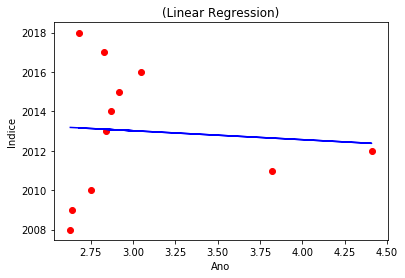

In [0]:
# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_1, y, test_size=0.3, random_state=42)



# Fitting Linear Regression to the dataset
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(X_1, y)



# Visualizing the Linear Regression results
#def viz_linear():
plt.scatter(X_1, y, color='red')
plt.plot(X_1, lin_reg.predict(X_1), color='blue')
plt.title('(Linear Regression)')
plt.xlabel('Ano')
plt.ylabel('Indice')
plt.show()
#return

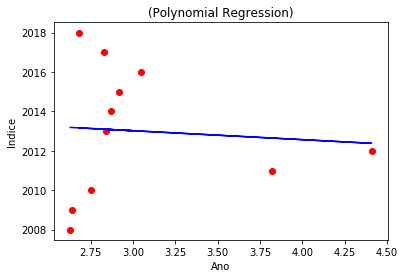

In [0]:
# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures
poly_reg = PolynomialFeatures(degree=1)
X_poly = poly_reg.fit_transform(X_1)
pol_reg = LinearRegression()
pol_reg.fit(X_poly, y)


# Visualizing the Polymonial Regression results
def viz_polymonial():
  plt.scatter(X_1, y, color='red')
  plt.plot(X_1, pol_reg.predict(poly_reg.fit_transform(X_1)), color='blue')
  plt.title('(Polynomial Regression)')
  plt.xlabel('Ano')
  plt.ylabel('Indice')
  plt.show()
  return
viz_polymonial()

In [0]:
# Predicting a new result with Linear Regression
lin_reg.predict([[2010]])
#output should be 249500

Out[24]: array([3.079])

In [0]:
# Predicting a new result with Polymonial Regression
pol_reg.predict(poly_reg.fit_transform([[2019]]))
#output should be 132148.43750003

Out[18]: array([[1099.15266595]])

In [0]:
from pyspark.sql.functions import greatest
df2 = df.withColumn('max_by_rows', greatest('col_1', 'col_2', 'col_3'))

#Only if you need col
#from pyspark.sql.functions import col
#df2 = df.withColumn('max', greatest(col('col_1'), col('col_2'), col('col_3')))
df2.show()

+-----+-----+-----+-----------+
|col_1|col_2|col_3|max_by_rows|
+-----+-----+-----+-----------+
|    1|    2|    3|          3|
|    2|    1|    2|          2|
|    3|    4|    5|          5|
+-----+-----+-----+-----------+

In [0]:
daniel = df_salario.groupBy(col('VL_DIAS_MENORES_15_CALC')).count()

In [0]:
daniel.display()

VL_DIAS_MENORES_15_CALC,count
7,45666
15,36134
11,29009
3,272279
8,37854
0,42982092
5,66770
6,74438
9,44941
1,441513


In [0]:
from pyspark.sql.functions import *
from pyspark.sql.types import *
from pyspark.sql.window import Window
import pyspark
 
# importing sparksessio
from pyspark.sql import SparkSession
 
# creating a sparksession object
# and providing appName
spark = SparkSession.builder.appName("pyspark_window").getOrCreate()
 
# sample data for dataframe
sampleData = (
  (2018, 28, 785),
  (2018, 33, 234),
  (2018, 40, 457),
  (2015, 25, 986),
  (2015, 29, 124),
  (2015, 46, 365),
  (2014, 26, 697),
  (2014, 30, 789),
  (2014, 29, 369),
  (2014, 39, 789)
)
 
  
# column names for dataframe
columns = ["DATA", "CNAE", "ABS"]
 
# creating the dataframe df
df = spark.createDataFrame(data=sampleData,
                           schema=columns)
df.display()

DATA,CNAE,ABS
2018,28,785
2018,33,234
2018,40,457
2015,25,986
2015,29,124
2015,46,365
2014,26,697
2014,30,789
2014,29,369
2014,39,789


In [0]:
# importing Window from pyspark.sql.window
 
# creating a window
# partition of dataframe
windowPartition = Window.partitionBy("DATA").orderBy(desc("ABS"))
 


In [0]:
windowPartition = Window.partitionBy("DATA").orderBy(desc("ABS"))
# show df
df.select('*', rank().over(windowPartition).alias('rank')).filter(col('rank') <= 5).show()

+----+----+---+----+
DATA|CNAE|ABS|rank|
+----+----+---+----+
2014| 30|789| 1|
2014| 39|789| 1|
2014| 26|697| 3|
2014| 29|369| 4|
2018| 28|785| 1|
2018| 40|457| 2|
2018| 33|234| 3|
2015| 25|986| 1|
2015| 46|365| 2|
2015| 29|124| 3|
+----+----+---+----+

In [0]:
%r

library(pracma)
clear()
library(readxl)
Dados <- read_excel("C:/Users/RCQ/Desktop/2021/Danilo_Markov/Programas/Renata/Quali/Primeira_Versão/04022022/Curso_CNI/Curso_Material/Dados.xlsx")
Dados=data.frame(Dados)
Resultado=matrix(0,15,6)

YX=matrix(0,20,4)

YX[,1]=Dados[,1]
YX[,2]=Dados[,2]
YX[,3]=ones(20,1)
k=1

for (i in 4:17){
YX[1:i,3]=0
YX[,4]=YX[,2]*YX[,3]
A=lm(YX[,1]~YX[,2]+YX[,3]+YX[,4])
B=summary(A)
C=B$r.squared
Resultado[k,1]=C
Resultado[k,2]=A$coefficients[1]
Resultado[k,3]=A$coefficients[2]
Resultado[k,4]=A$coefficients[3]
Resultado[k,5]=A$coefficients[4]
Resultado[k,6]=i+1
k=k+1
}

A1=lm(YX[,1]~YX[,2])
B1=summary(A)
C1=B1$r.squared
Resultado[15,1]=C1
Resultado[15,2]=A1$coefficients[1]
Resultado[15,3]=A1$coefficients[2]
Resultado[15,4]=0
Resultado[15,5]=0
Resultado[15,6]=0

Resultado=sortrows(Resultado,1)
Nomes=c("R2","Inter","X","D","X*D","Posi_D")
colnames(Resultado)<-Nomes

Previ<-matrix(0,20,3)

Previ[,1]=1:20
Previ[,2]=Dados[,1]
YX[,3]=ones(20,1)
x=Resultado[15,6]
YX[1:x,3]=0
YX[,4]=YX[,3]*Dados[,2]


Previ[,3]=Resultado[15,2]+Resultado[15,3]*Dados[,2]+
  Resultado[15,4]*YX[,3]+Resultado[15,5]*YX[,4]

plot(Previ[,1],Previ[,2],col="red",type="b")
par(new=T)
plot(Previ[,1],Previ[,3],col="blue")

In [0]:
 Dados = ANO_2008_2018.select('INDICE_ABSENTEÍSMO', 'ANO')

--------------------------------------------------------------------------- 
 NameError Traceback (most recent call last)
 <command-573443468885> in <module> 
 ----> 1 Dados = ANO_2008_2018 . select ( 'INDICE_ABSENTEÍSMO' , 'ANO' ) 

 NameError : name 'ANO_2008_2018' is not defined

In [0]:
%r

Dados=data.frame(Dados)
Dados$INDICE_ABSENTEÍSMO = as.numeric(Dados$INDICE_ABSENTEÍSMO)
Resultado=matrix(0,15,6)
YX=matrix(0,16,4)
YX[,1]=Dados[,1]
YX[,2]=Dados[,2]
YX[,3]=ones(16,1)
k=1
for (i in 4:17){
YX[1:i,3]=0
YX[,4]=YX[,2]*YX[,3]
A=lm(YX[,1]~YX[,2]+YX[,3]+YX[,4])
B=summary(A)
C=B$r.squared
Resultado[k,1]=C
Resultado[k,2]=A$coefficients[1]
Resultado[k,3]=A$coefficients[2]
Resultado[k,4]=A$coefficients[3]
Resultado[k,5]=A$coefficients[4]
Resultado[k,6]=i+1
k=k+1
}
A1=lm(YX[,1]~YX[,2])
B1=summary(A)
C1=B1$r.squared
Resultado[15,1]=C1
Resultado[15,2]=A1$coefficients[1]
Resultado[15,3]=A1$coefficients[2]
Resultado[15,4]=0
Resultado[15,5]=0
Resultado[15,6]=0
Resultado=sortrows(Resultado,1)
Nomes=c("R2","Inter","X","D","X*D","Posi_D")
colnames(Resultado)<-Nomes
Previ<-matrix(0,16,3)
Previ[,1]=1:16
Previ[,2]=Dados[,1]
YX[,3]=ones(16,1)
x=Resultado[15,6]
YX[1:x,3]=0
YX[,4]=YX[,3]*Dados[,2]
Previ[,3]=Resultado[15,2]+Resultado[15,3]*Dados[,2]+
  Resultado[15,4]*YX[,3]+Resultado[15,5]*YX[,4]
plot(Previ[,1],Previ[,2],col="red",type="b")
par(new=T)
plot(Previ[,1],Previ[,3],col="blue")
resultados = data.frame(Previ)
resultados$X1 = Dados$ANO
names(resultados) = c('Ano', 'Absenteismo', 'Abs_Proj')